In [1]:
import scanpy as sc
import warnings
# To ignore Pandas Future Warning
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import phenograph
import copy
from scipy import sparse
from sklearn.metrics import adjusted_rand_score
import seaborn as sns
#%matplotlib inline
import anndata as ad 

In [2]:
lineage = ['CD14(Nd143)', 'CD16(Sm147)', 'panCytokeratin(Nd148)', 'XCR1(Sm149)',
       'FOXP3(Gd155)', 'CD4(Gd156)', 'CD68(Tb159)', 'NKp46(Dy161)',
       'CD8a(Dy162)', 'CD3(Yb170)', 'CD66b(Yb174)','GATA3(Yb171)', 'EpCAM(Nd144)' ]

In [60]:
adata = ad.read_h5ad("cluster_1.h5ad")


/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


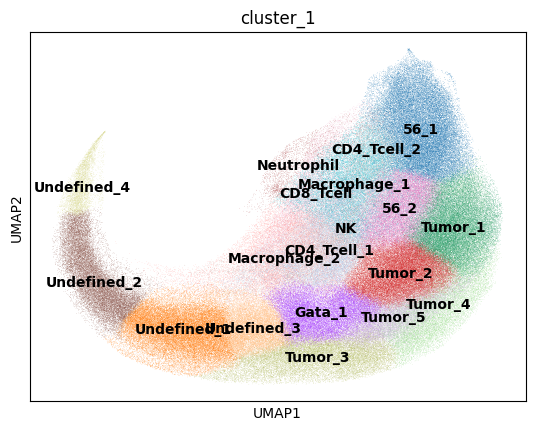

In [13]:
sc.pl.umap(adata, color=['cluster_1'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


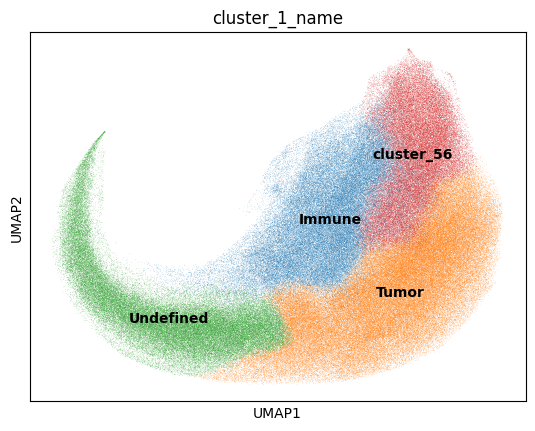

In [14]:
sc.pl.umap(adata, color=['cluster_1_name'],legend_loc='on data')

In [20]:
lineage = ['CD14(Nd143)', 'CD16(Sm147)', 'panCytokeratin(Nd148)', 'GATA3(Yb171)', 'XCR1(Sm149)',
       'FOXP3(Gd155)', 'CD4(Gd156)', 'CD68(Tb159)', 'NKp46(Dy161)',
       'CD8a(Dy162)', 'CD3(Yb170)', 'CD66b(Yb174)','EpCAM(Nd144)']

In [ ]:
#adata.obs

In [16]:
Immune = ['Macrophage_1', 'CD4_Tcell_1','Macrophage_2','NK',
          'CD8_Tcell','CD4_Tcell_2', 'Neutrophil']

Tumor = ['Tumor_1', 'Tumor_2', 
    'Gata_1', 'Tumor_3', 
    'Tumor_4',  'Tumor_5'] 

cluster_56 = ['56_1','56_2']

Undefined = ['Undefined_1', 'Undefined_2','Undefined_3','Undefined_4'] 

adata_Immune = adata [adata.obs['cluster_1'].isin(Immune)]
adata_Tumor = adata [adata.obs['cluster_1'].isin(Tumor)]
adata_cluster_56 = adata[adata.obs['cluster_1'].isin(cluster_56)]
adata_Undefined = adata[adata.obs['cluster_1'].isin(Undefined)] 

In [17]:
adata_Immune

View of AnnData object with n_obs × n_vars = 80881 × 33
    obs: 'sample', 'roi', 'obj_id', 'X_centroid', 'Y_centroid', 'area', 'perimeter', 'minor_axis_length', 'major_axis_length', 'eccentricity', 'solidity', 'n_protein_by_counts', 'total_counts', 'cell_count', 'mob_id', 'pre_post', 'mob', 'cell_id', 'leiden', 'cluster_1', 'cluster_1_name'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'markers', 'channel', 'total_signal', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cluster_1_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'moved_genes', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'cluster_1_name_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'log', 'raw', 'z_scale'
    obsp: 'connectivities', 'distances'

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


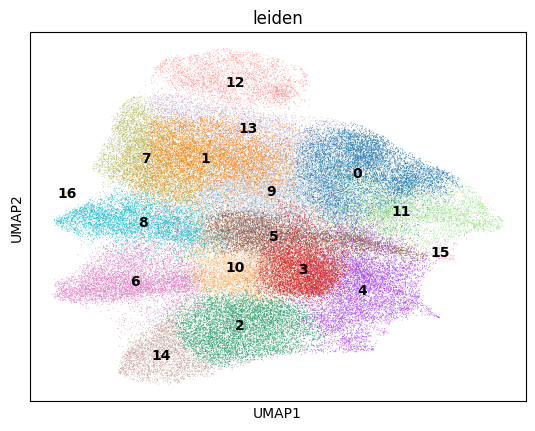

In [18]:
sc.pp.neighbors(adata_Immune,use_rep='X_pca_harmony', n_neighbors = 30) 
sc.tl.umap(adata_Immune)
sc.tl.leiden(adata_Immune, resolution=1)
sc.pl.umap(adata_Immune, color=['leiden'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


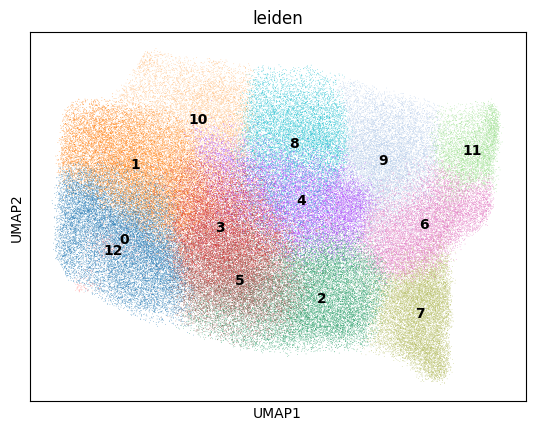

In [19]:
sc.pp.neighbors(adata_Tumor,use_rep='X_pca_harmony', n_neighbors = 30) 
sc.tl.umap(adata_Tumor)
sc.tl.leiden(adata_Tumor, resolution=1)
sc.pl.umap(adata_Tumor, color=['leiden'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


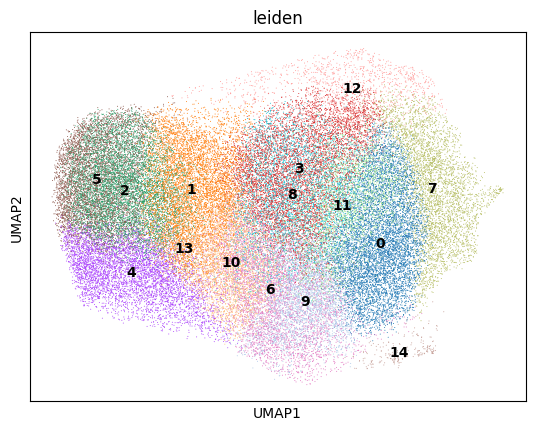

In [20]:
sc.pp.neighbors(adata_cluster_56,use_rep='X_pca_harmony', n_neighbors = 30) 
sc.tl.umap(adata_cluster_56)
sc.tl.leiden(adata_cluster_56, resolution=1)
sc.pl.umap(adata_cluster_56, color=['leiden'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


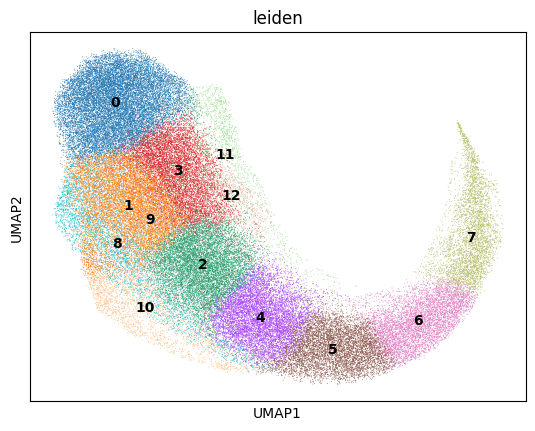

In [21]:
sc.pp.neighbors(adata_Undefined,use_rep='X_pca_harmony', n_neighbors = 30) 
sc.tl.umap(adata_Undefined)
sc.tl.leiden(adata_Undefined, resolution=1)
sc.pl.umap(adata_Undefined, color=['leiden'],legend_loc='on data')

In [22]:
adata_Immune.write('adata_Immune.h5ad') 
adata_Tumor.write('adata_Tumor.h5ad') 
adata_cluster_56.write('adata_cluster_56.h5ad') 
adata_Undefined.write('adata_Undefined.h5ad') 

In [3]:
adata_Immune= ad.read_h5ad('adata_Immune.h5ad') 
adata_Tumor= ad.read_h5ad('adata_Tumor.h5ad') 
adata_cluster_56= ad.read_h5ad('adata_cluster_56.h5ad') 
adata_Undefined= ad.read_h5ad('adata_Undefined.h5ad') 

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

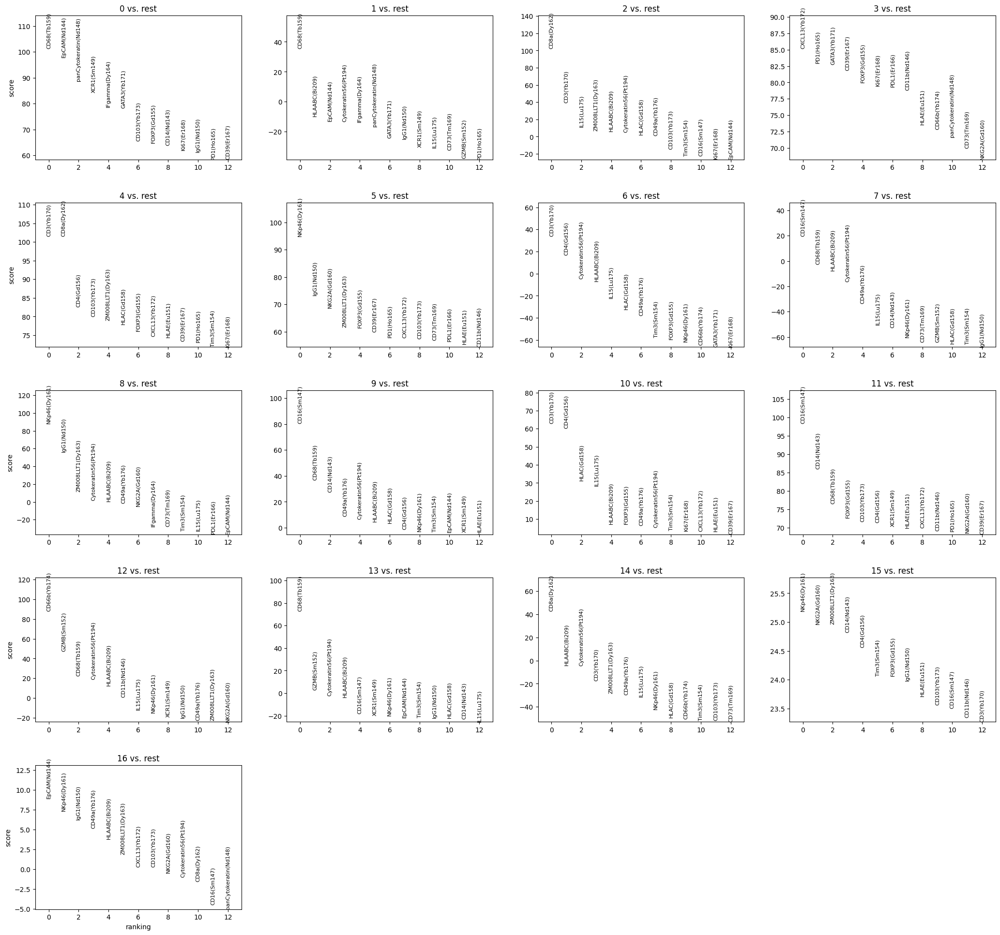

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered i

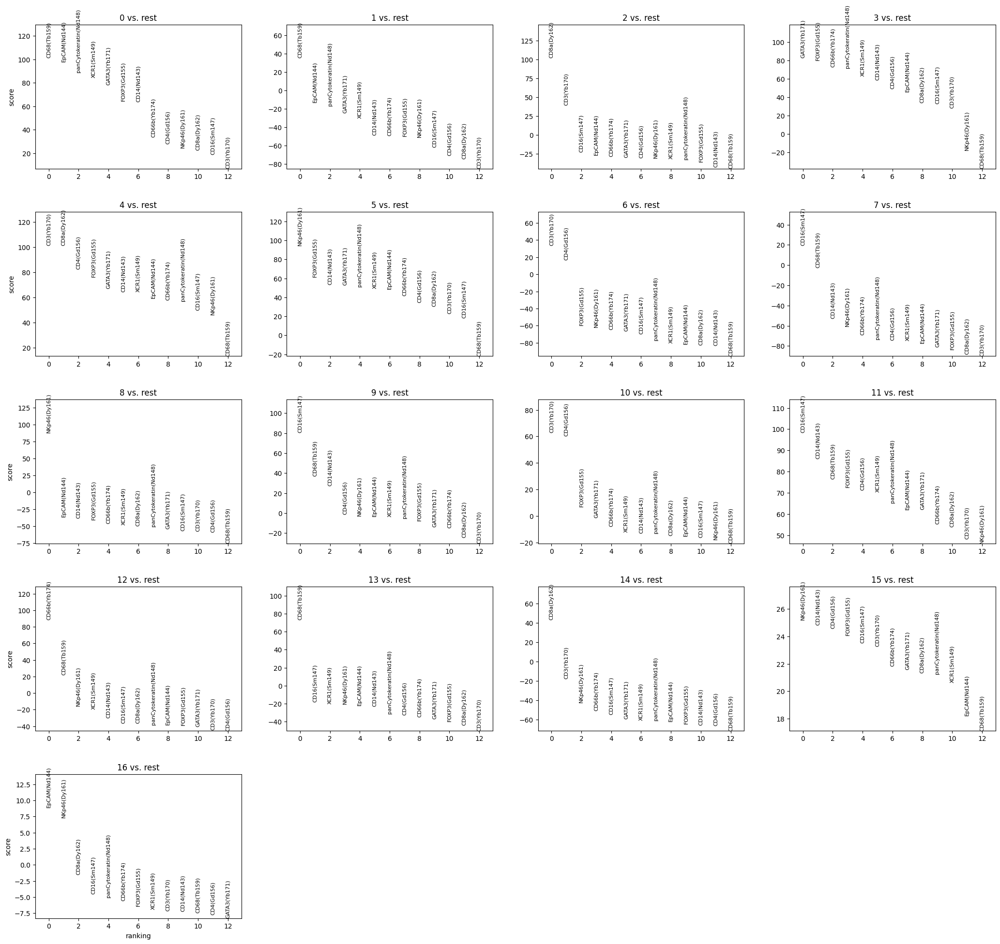

In [13]:
adata_Immune.obs['cluster_2'] = adata_Immune.obs['leiden']
sc.tl.rank_genes_groups(adata_Immune, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Immune, n_genes=13, sharey=False)
adata_Immune_lineage = adata_Immune[:,adata_Immune.var_names.isin(lineage)]
adata_Immune_lineage.shape
sc.tl.rank_genes_groups(adata_Immune_lineage, 'leiden', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Immune_lineage, n_genes=13, sharey=False)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

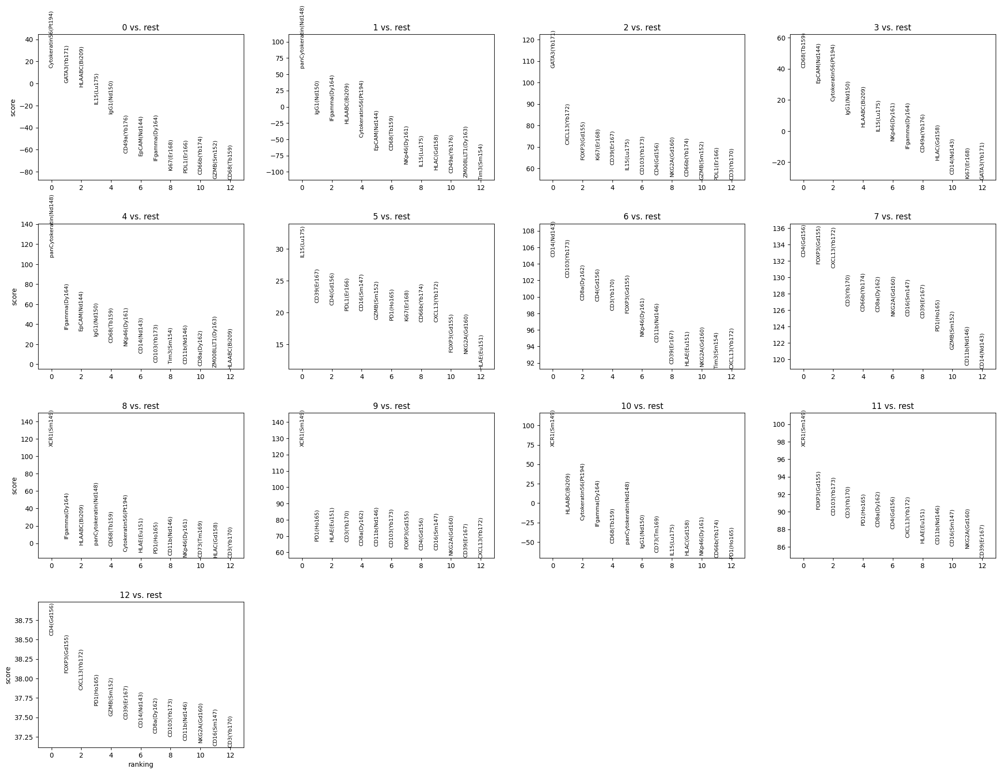

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered i

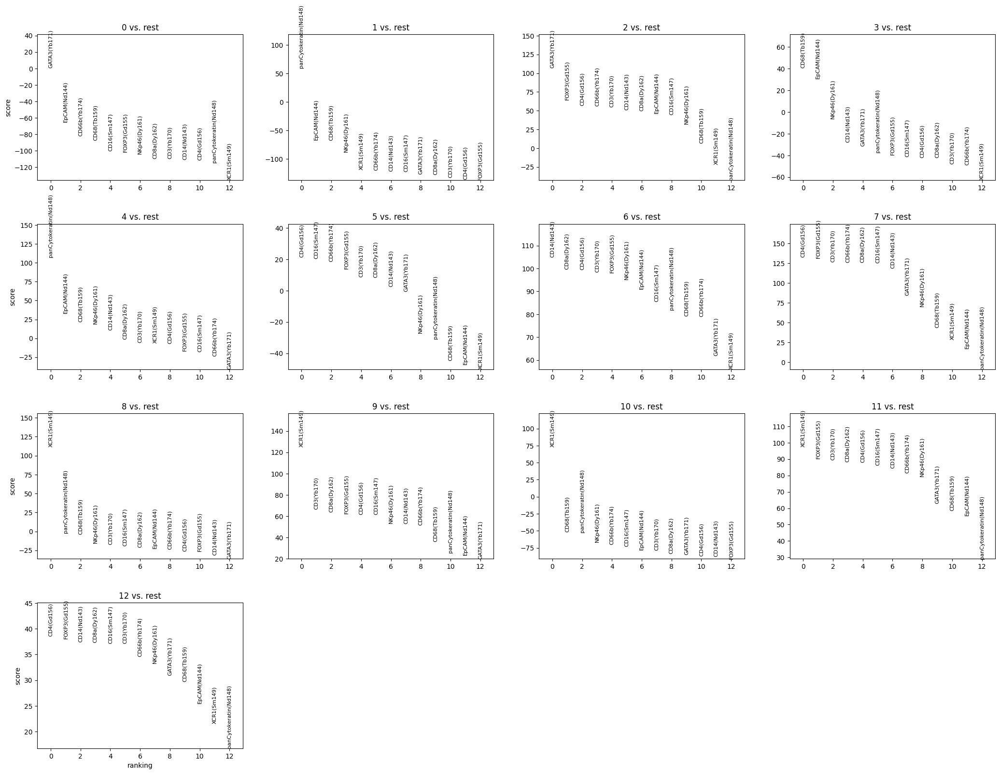

In [27]:
adata_Tumor.obs['cluster_2'] = adata_Tumor.obs['leiden']
sc.tl.rank_genes_groups(adata_Tumor, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Tumor, n_genes=13, sharey=False)
adata_Tumor_lineage = adata_Tumor[:,adata_Tumor.var_names.isin(lineage)]
adata_Tumor_lineage.shape
sc.tl.rank_genes_groups(adata_Tumor_lineage, 'leiden', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Tumor_lineage, n_genes=13, sharey=False)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

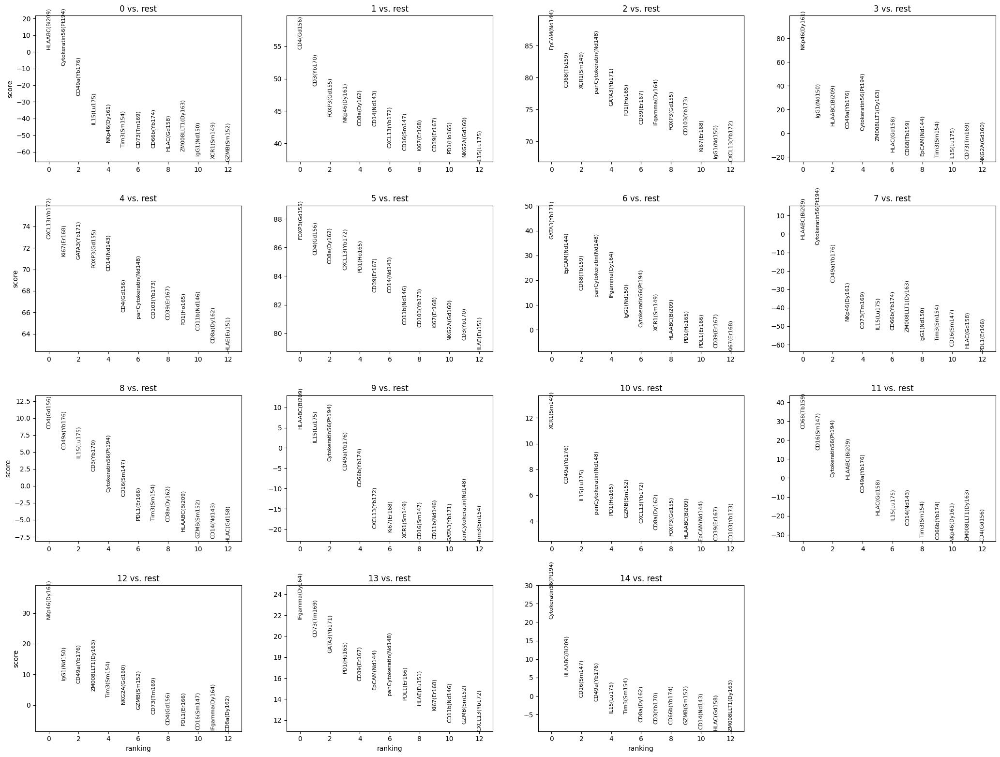

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


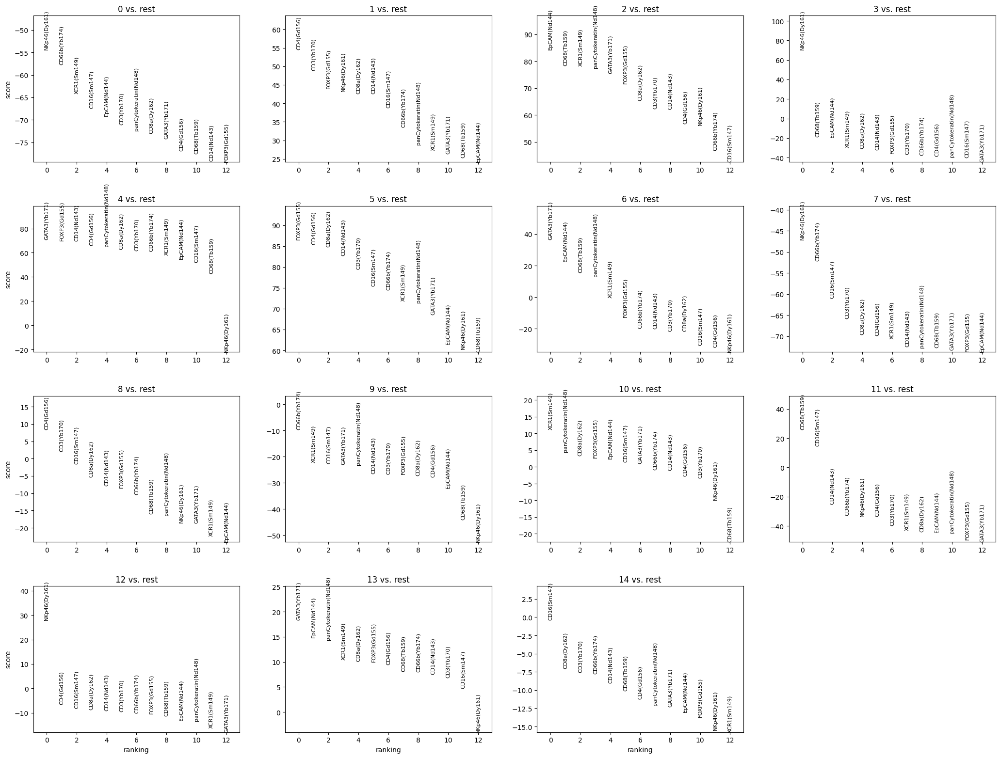

In [31]:
adata_cluster56.obs['cluster_2'] = adata_cluster56.obs['leiden']
sc.tl.rank_genes_groups(adata_cluster56, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_cluster56, n_genes=13, sharey=False)
adata_cluster56_lineage = adata_cluster56[:,adata_cluster56.var_names.isin(lineage)]
adata_cluster56_lineage.shape
sc.tl.rank_genes_groups(adata_cluster56_lineage, 'leiden', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_cluster56_lineage, n_genes=13, sharey=False)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


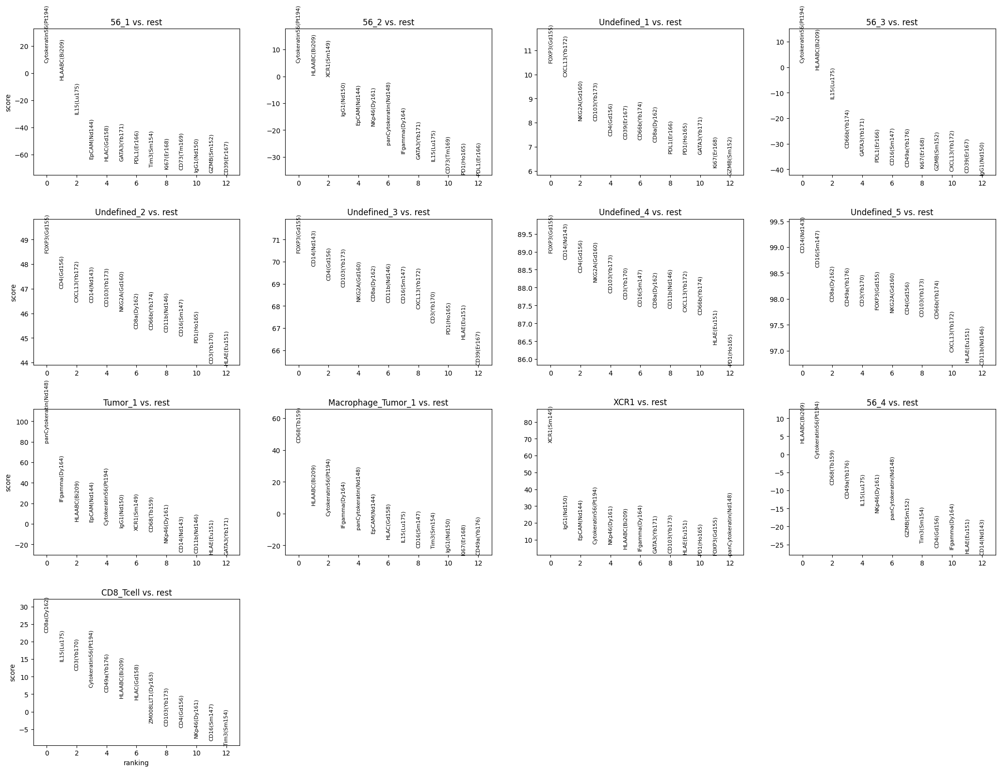

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


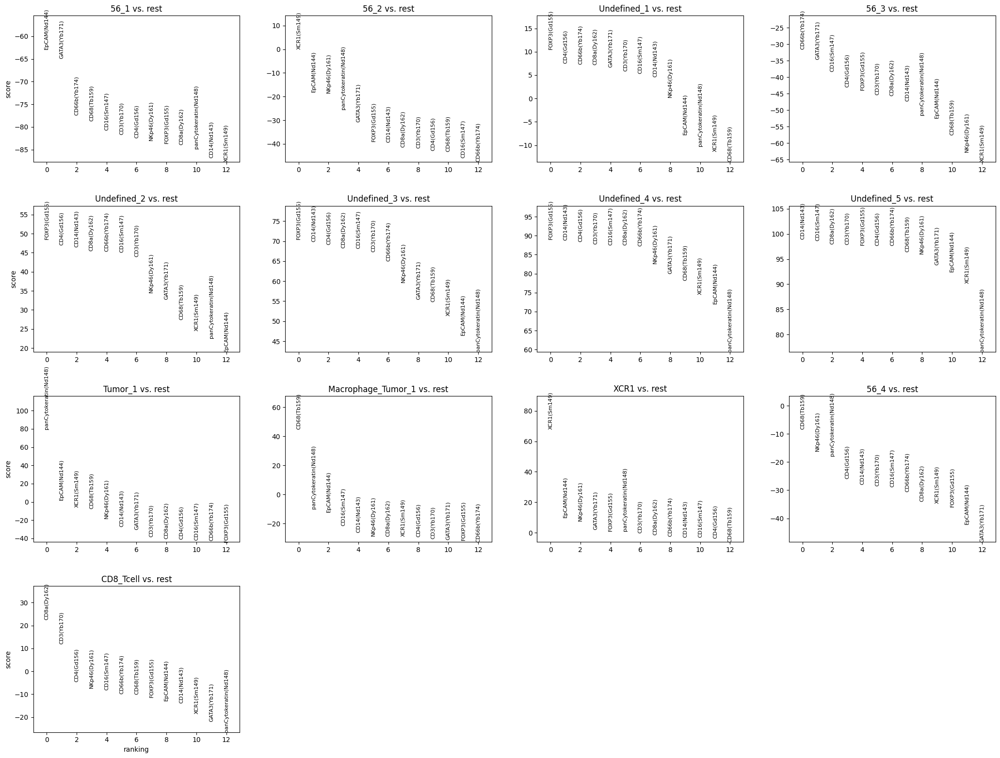

In [39]:
#adata_Undefined.obs['cluster_2'] = adata_Undefined.obs['leiden']
sc.tl.rank_genes_groups(adata_Undefined, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Undefined, n_genes=13, sharey=False)
adata_Undefined_lineage = adata_Undefined[:,adata_Undefined.var_names.isin(lineage)]
adata_Undefined_lineage.shape
sc.tl.rank_genes_groups(adata_Undefined_lineage, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Undefined_lineage, n_genes=13, sharey=False)

In [10]:
adata_Immune = ad.read_h5ad('adata_Immune.h5ad') 
adata_Tumor = ad.read_h5ad('adata_Tumor.h5ad') 
adata_cluster56 = ad.read_h5ad('adata_cluster_56.h5ad') 
adata_Undefined = ad.read_h5ad('adata_Undefined.h5ad') 

In [21]:
#adata.obs

In [19]:
Immune_cluster_names = [
    'Macrophage_Tumor', 'Macrophage_1', 'CD8_Tcell_1', 'Undefined_1',
    'CD8_Tcell_2', 'NK_1', 'CD4_Tcell_1', 'CD16_Macrophage',
    'NK_2', 'CD16_Macrophage_CD14', 'CD4_Tcell_2', 'CD16_CD14_Macrophage',
    'Neutrophil', 'Macrophage_2', 'CD8_Tcell_3', 'Immune_1',
    'EPCAM_NK'] 
adata_Immune.rename_categories('cluster_2', Immune_cluster_names)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered i

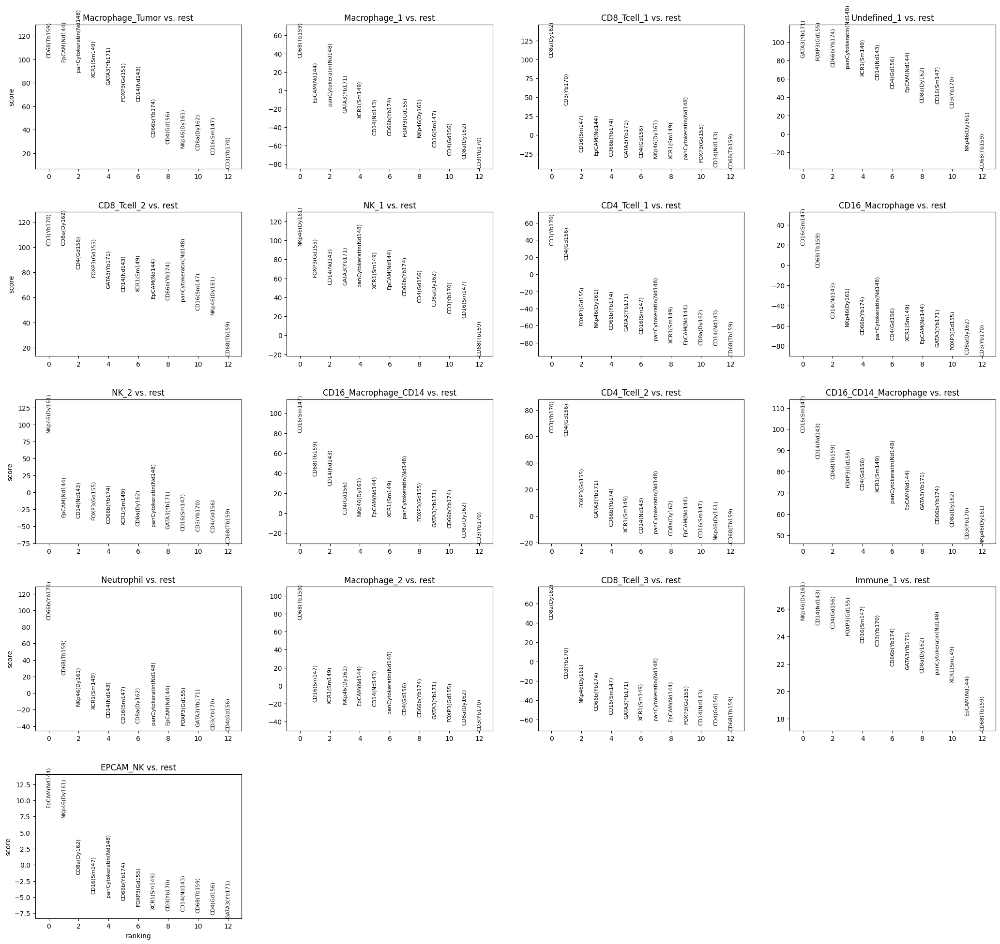

In [20]:
adata_Immune_lineage = adata_Immune[:,adata_Immune.var_names.isin(lineage)]
adata_Immune_lineage.shape
sc.tl.rank_genes_groups(adata_Immune_lineage, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Immune_lineage, n_genes=13, sharey=False)

In [69]:
Tumor_cluster_names = [
    '56_GATA', 'Tumor_1', 'GATA_1', 'CD68_EPCAM',
    'Tumor_2', 'Dim_Immune_1', 'Immune_1', 'Immune_2',
    'XCR1_Tumor', 'XCR1_1', 'XCR1_2', 'Immune_3',
    'Immune_4'] 
adata_Tumor.rename_categories('cluster_2', Tumor_cluster_names)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

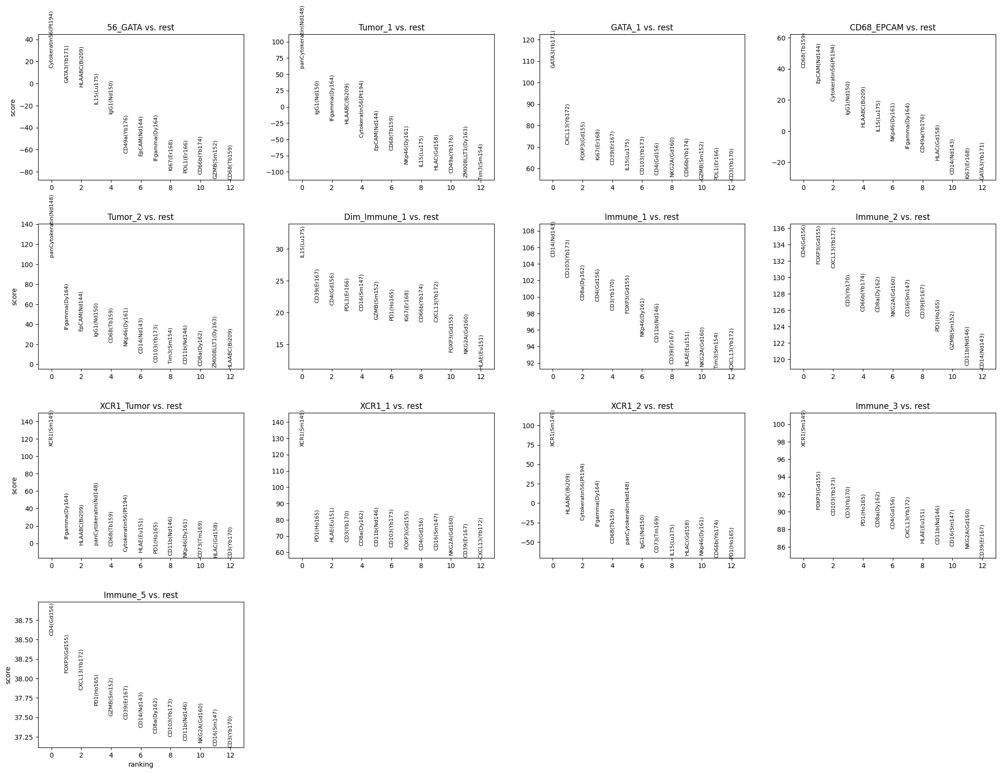

In [67]:
sc.tl.rank_genes_groups(adata_Tumor, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Tumor, n_genes=13, sharey=False)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered i

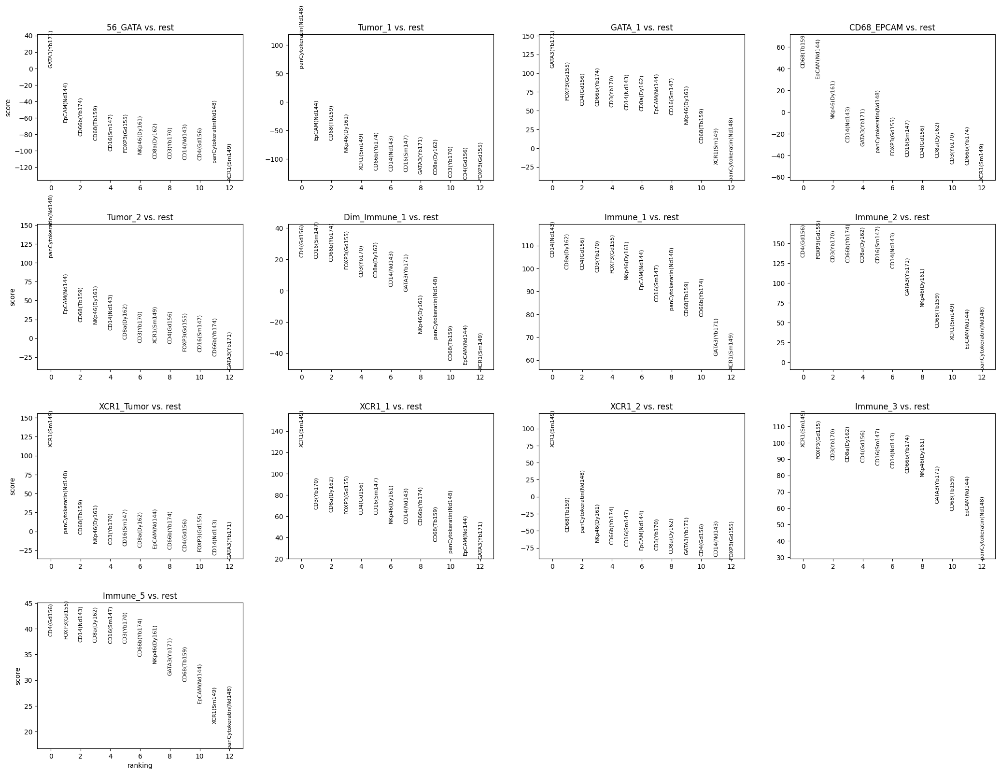

In [66]:
adata_Tumor_lineage = adata_Tumor[:,adata_Tumor.var_names.isin(lineage)]
adata_Tumor_lineage.shape
sc.tl.rank_genes_groups(adata_Tumor_lineage, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Tumor_lineage, n_genes=13, sharey=False)

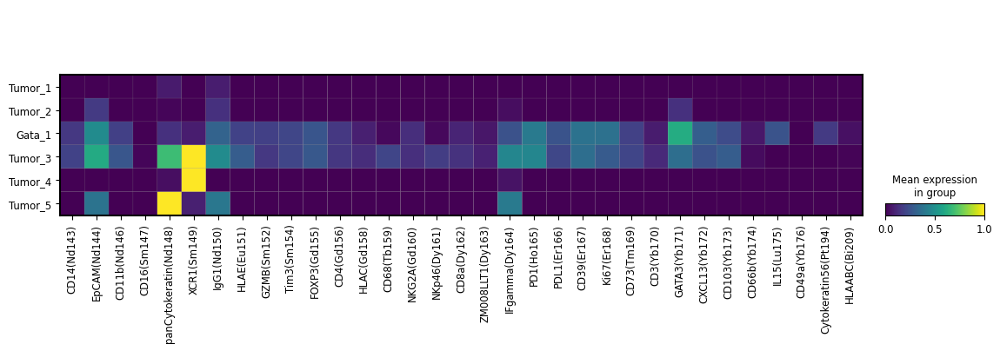

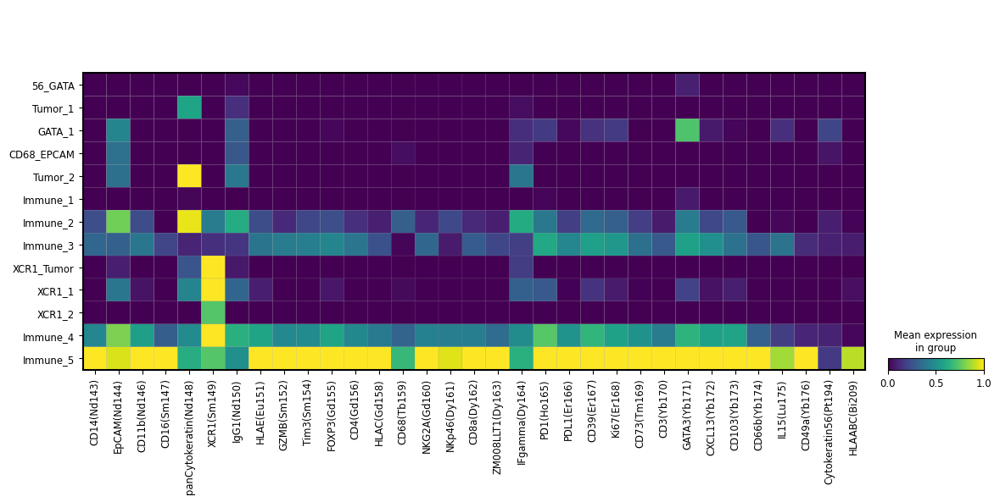

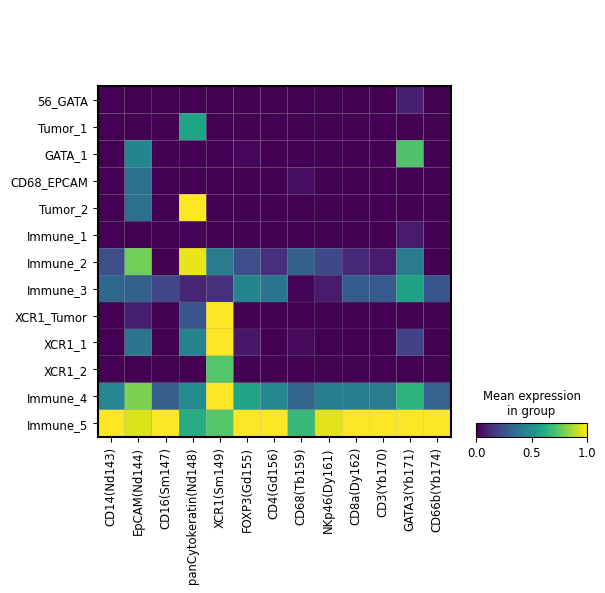

In [64]:
sc.pl.matrixplot(adata_Tumor, adata_Tumor.var_names, 'cluster_1',vmin =0, vmax=1)
sc.pl.matrixplot(adata_Tumor, adata_Tumor.var_names, 'cluster_2',vmin =0, vmax=1)
highly_variable_genes = adata_Tumor.var_names[adata_Tumor.var['highly_variable']]
sc.pl.matrixplot(adata_Tumor, highly_variable_genes, 'cluster_2',vmin =0, vmax=1)

In [40]:
cluster_56_cluster_names = [
    '56_1', 'CD4_Tcell_1', 'Tumor_Macrophage_1', 'NK_1',
    'Undefined_1', 'Tcell', 'Tumor_Macrophage_2', '56_2',
    'CD4_Tcell_2', '56_3', 'XCR1', 'Macrophage_1',
    'NK_2', 'Tumor', '56_4'] 
adata_cluster_56.rename_categories('cluster_2', cluster_56_cluster_names)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

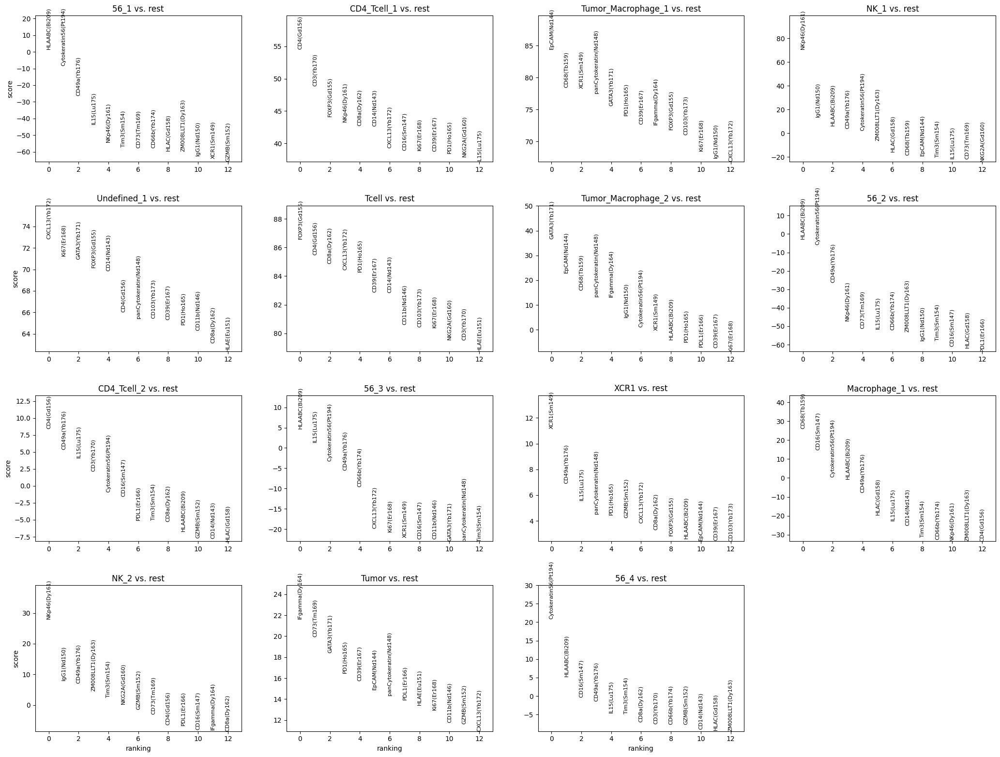

In [41]:
sc.tl.rank_genes_groups(adata_cluster_56, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_cluster_56, n_genes=13, sharey=False)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


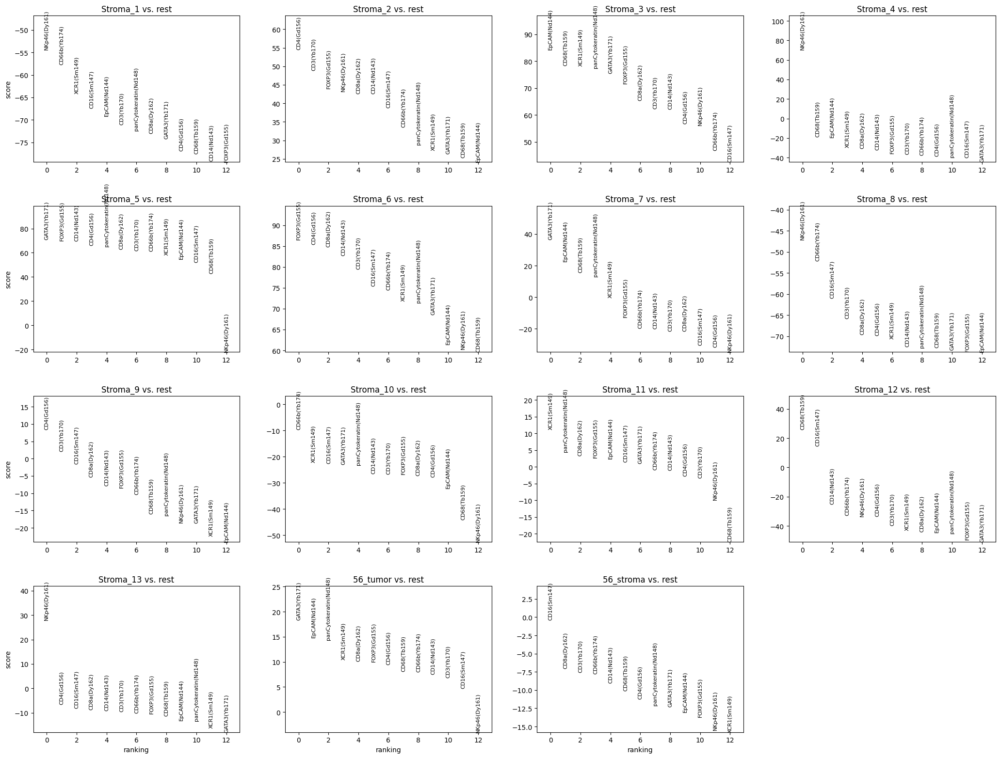

In [107]:
adata_cluster_56_lineage = adata_cluster_56[:,adata_cluster_56.var_names.isin(lineage)]
adata_cluster_56_lineage.shape
sc.tl.rank_genes_groups(adata_cluster_56_lineage, 'alt_name', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_cluster_56_lineage, n_genes=13, sharey=False)

In [92]:
adata_Undefined_cluster_names = [
    '56_1', '56_2', 'Immune_1', '56_3',
    'Immune_2', 'Immune_3', 'Immune_4', 'Immune_5',
    'Tumor_1', 'Macrophage_1', 'XCR1', '56_4',
    'CD8_Tcell'] 
adata_Undefined.rename_categories('cluster_2', adata_Undefined_cluster_names)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


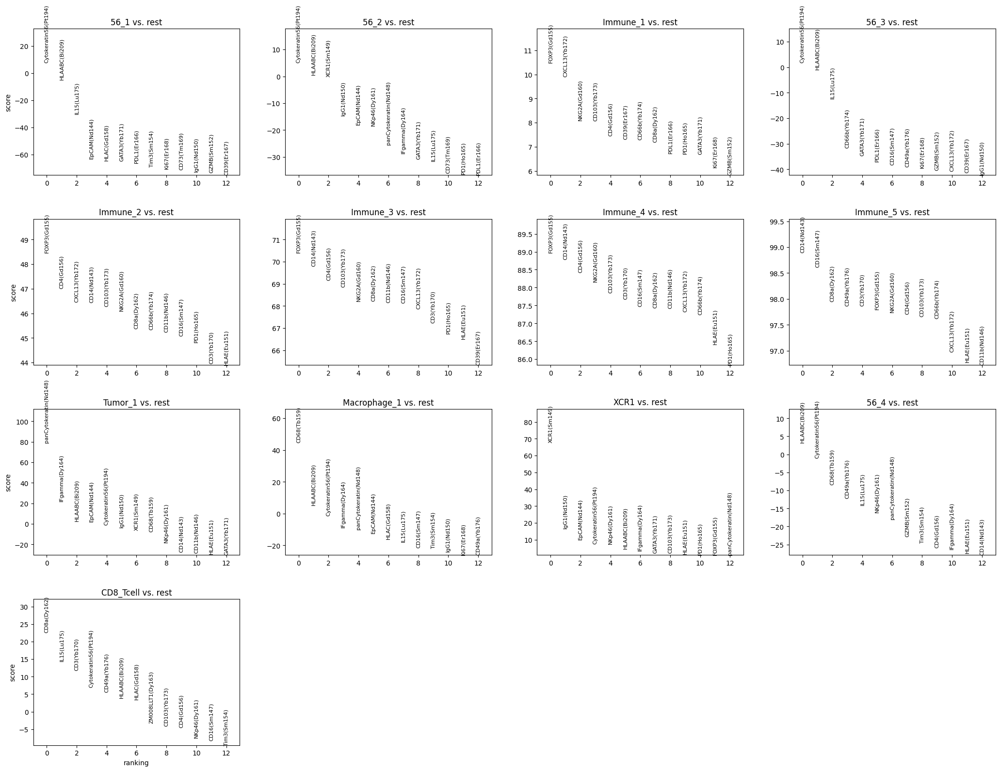

In [57]:
sc.tl.rank_genes_groups(adata_Undefined, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Undefined, n_genes=13, sharey=False)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


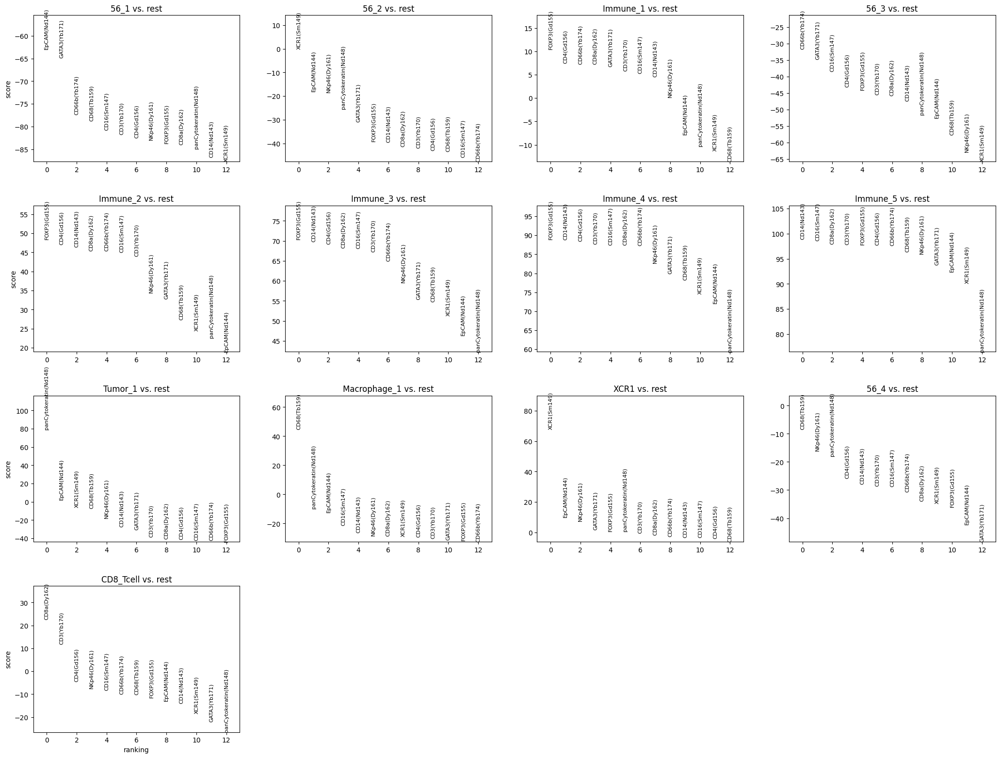

In [58]:
adata_Undefined_lineage = adata_Undefined[:,adata_Undefined.var_names.isin(lineage)]
adata_Undefined_lineage.shape
sc.tl.rank_genes_groups(adata_Undefined_lineage, 'cluster_2', method='wilcoxon') 
sc.pl.rank_genes_groups(adata_Undefined_lineage, n_genes=13, sharey=False)

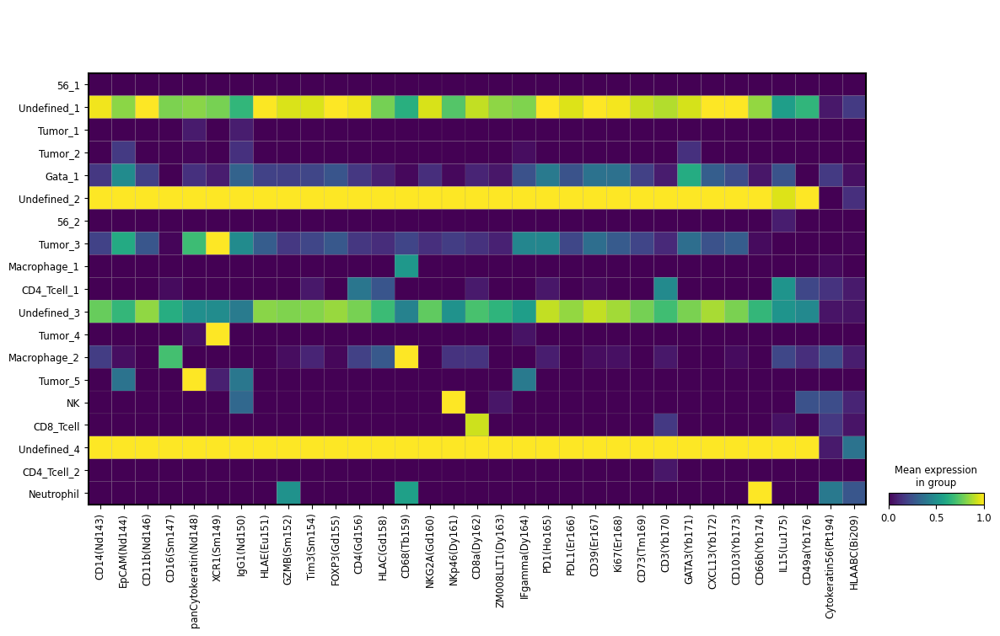

In [61]:
sc.pl.matrixplot(adata, adata.var_names, 'cluster_1',vmin =0, vmax=1)

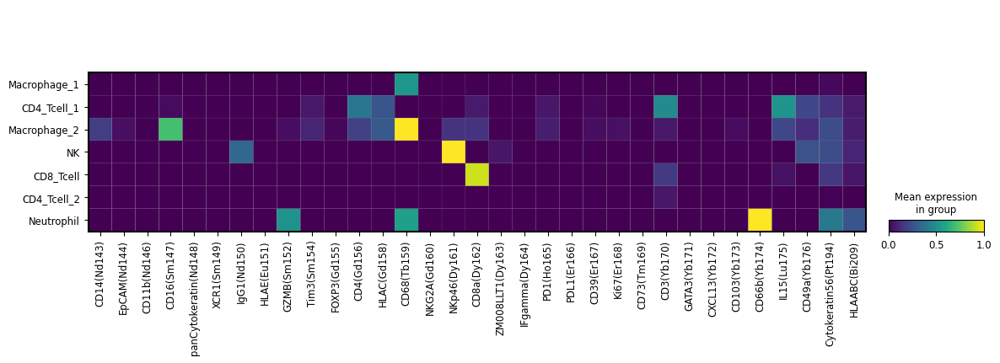

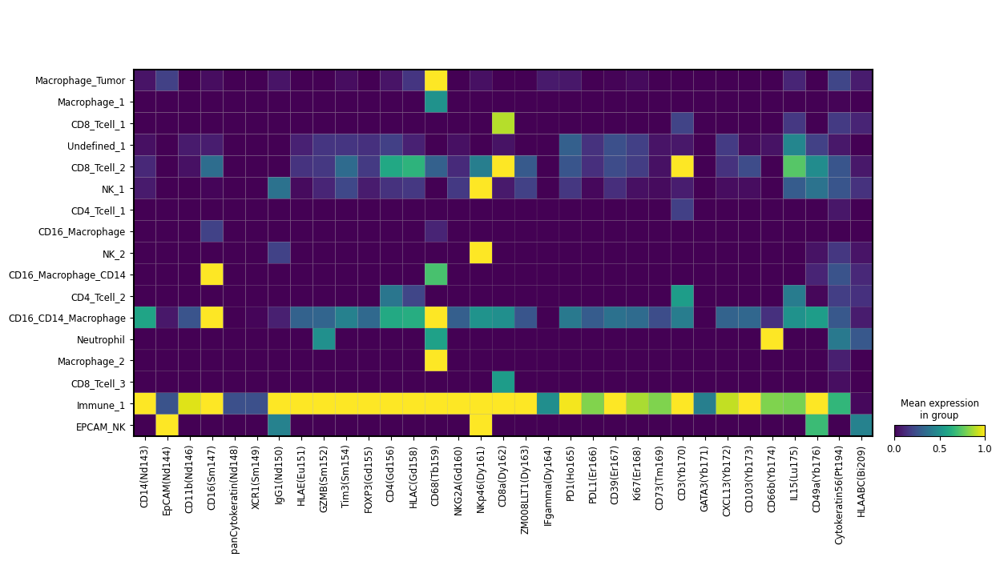

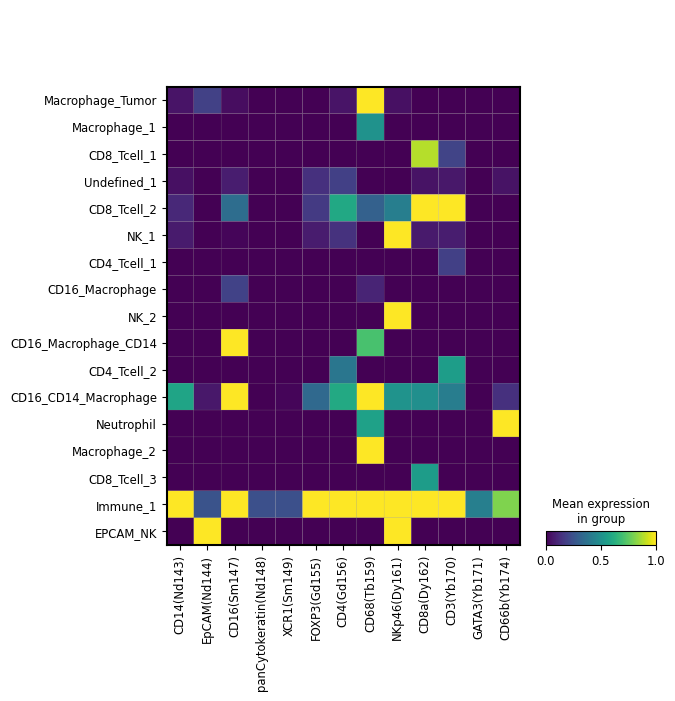

In [62]:
sc.pl.matrixplot(adata_Immune, adata.var_names, 'cluster_1',vmin =0, vmax=1)
sc.pl.matrixplot(adata_Immune, adata.var_names, 'cluster_2',vmin =0, vmax=1)
highly_variable_genes = adata_Immune.var_names[adata_Immune.var['highly_variable']]
sc.pl.matrixplot(adata_Immune, highly_variable_genes, 'cluster_2',vmin =0, vmax=1)

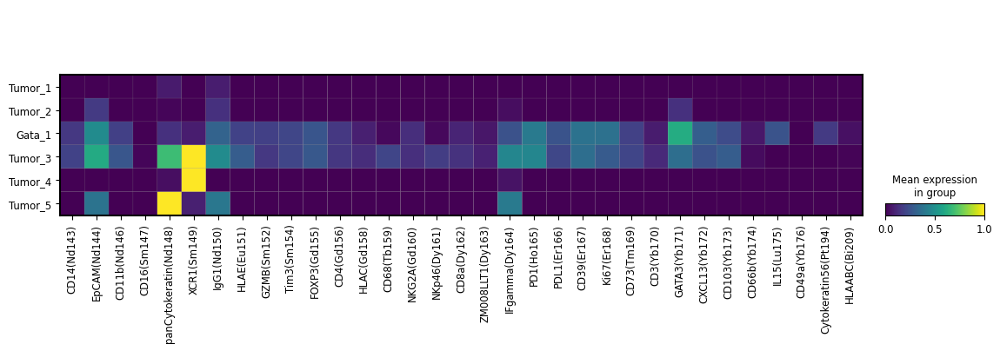

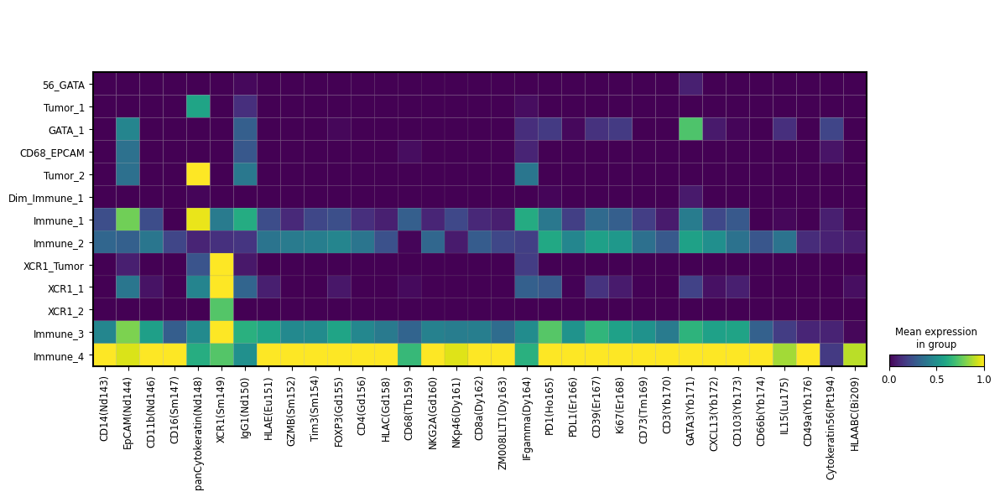

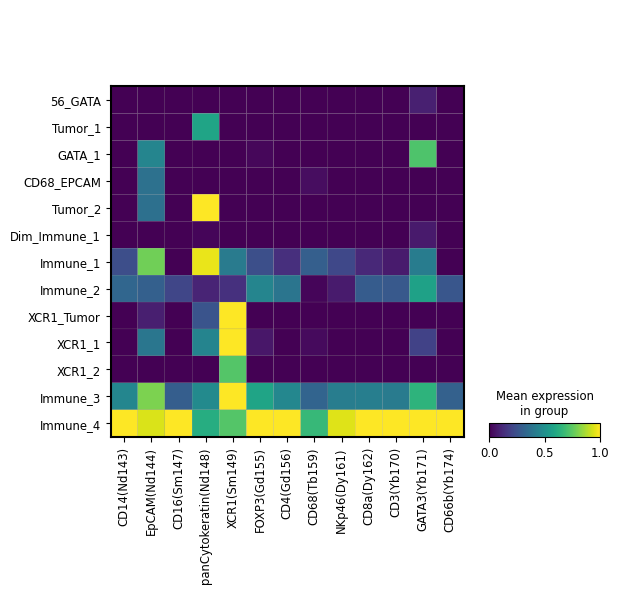

In [70]:
sc.pl.matrixplot(adata_Tumor, adata_Tumor.var_names, 'cluster_1',vmin =0, vmax=1)
sc.pl.matrixplot(adata_Tumor, adata_Tumor.var_names, 'cluster_2',vmin =0, vmax=1)
highly_variable_genes = adata_Tumor.var_names[adata_Tumor.var['highly_variable']]
sc.pl.matrixplot(adata_Tumor, highly_variable_genes, 'cluster_2',vmin =0, vmax=1)

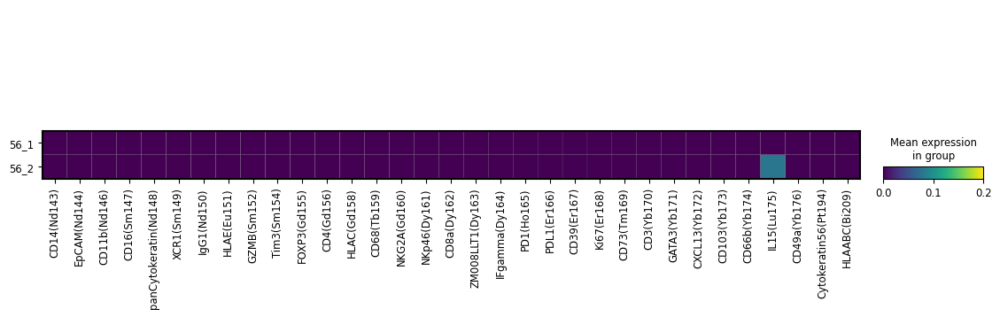

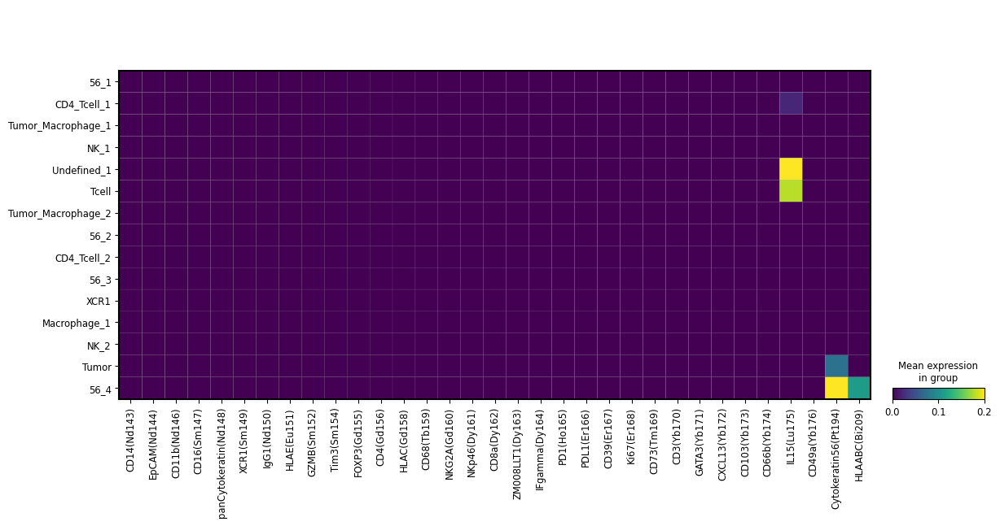

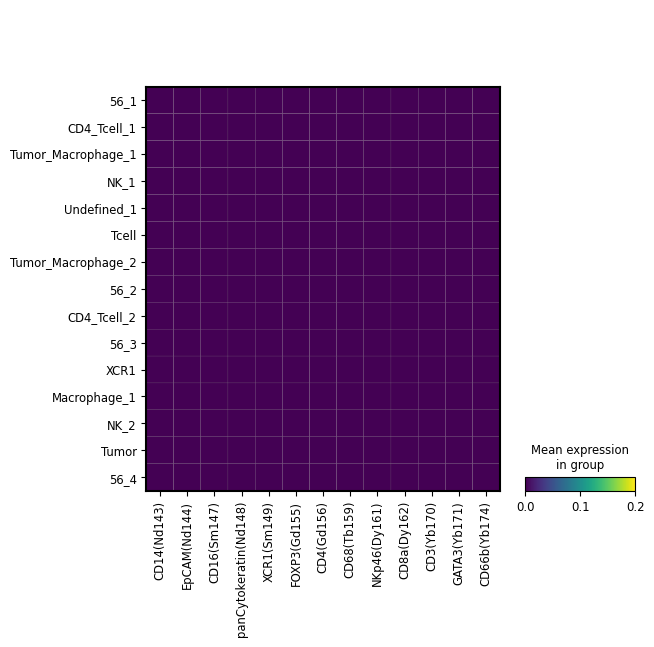

In [73]:
sc.pl.matrixplot(adata_cluster_56, adata_cluster_56.var_names, 'cluster_1',vmin =0, vmax=0.2)
sc.pl.matrixplot(adata_cluster_56, adata_cluster_56.var_names, 'cluster_2',vmin =0, vmax=0.2)
highly_variable_genes = adata_cluster_56.var_names[adata_cluster_56.var['highly_variable']]
sc.pl.matrixplot(adata_cluster_56, highly_variable_genes, 'cluster_2',vmin =0, vmax=0.2)

In [80]:
adata_cluster_56.obs['alt_name'] = adata_cluster_56.obs['cluster_2']

In [82]:
#del adata_cluster_56.obs['dim_name']


In [83]:
adata_cluster_56.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,cell_count,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,1534,1371_pre,pre,1371,cell_4,4,56_2,cluster_56,Undefined_1,Undefined_1
230807_BCG01_Area3-01-0017,230807_BCG01_Area3,230807_BCG01_Area3-01,17,29.490741,146.907407,108.0,37.798990,10.807429,13.005192,0.556259,...,1534,1371_pre,pre,1371,cell_14,5,56_2,cluster_56,Tcell,Tcell
230807_BCG01_Area3-01-0021,230807_BCG01_Area3,230807_BCG01_Area3-01,21,33.734694,157.071429,98.0,34.970563,10.252960,12.227253,0.544850,...,1534,1371_pre,pre,1371,cell_18,10,56_1,cluster_56,XCR1,XCR1
230807_BCG01_Area3-01-0028,230807_BCG01_Area3,230807_BCG01_Area3-01,28,40.700000,151.211111,90.0,35.213203,9.856474,11.936273,0.564024,...,1534,1371_pre,pre,1371,cell_25,2,56_2,cluster_56,Tumor_Macrophage_1,Tumor_Macrophage_1
230807_BCG01_Area3-01-0050,230807_BCG01_Area3,230807_BCG01_Area3-01,50,67.363636,193.402597,77.0,31.727922,9.327437,10.667537,0.485249,...,1534,1371_pre,pre,1371,cell_47,1,56_2,cluster_56,CD4_Tcell_1,CD4_Tcell_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1207,BCG02_230627,BCG02_230627-03,1207,584.215686,445.284314,102.0,35.556349,9.362376,13.919742,0.740009,...,1197,2138_pre,pre,2138,cell_360661,4,56_2,cluster_56,Undefined_1,Undefined_1
BCG02_230627-03-1211,BCG02_230627,BCG02_230627-03,1211,587.439394,456.227273,66.0,28.142136,8.309884,10.150384,0.574255,...,1197,2138_pre,pre,2138,cell_360665,11,56_1,cluster_56,Macrophage_1,Macrophage_1
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,1197,2138_pre,pre,2138,cell_360668,10,56_1,cluster_56,XCR1,XCR1
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,1197,2138_pre,pre,2138,cell_360669,1,56_2,cluster_56,CD4_Tcell_1,CD4_Tcell_1


In [106]:
dim_cluster_56_cluster_names = [
    'Stroma_1', 'Stroma_2', 'Stroma_3', 'Stroma_4',
    'Stroma_5', 'Stroma_6', 'Stroma_7', 'Stroma_8',
    'Stroma_9', 'Stroma_10', 'Stroma_11', 'Stroma_12',
    'Stroma_13', '56_tumor', '56_stroma'] 
adata_cluster_56.rename_categories('alt_name', dim_cluster_56_cluster_names)

In [86]:
adata_cluster_56.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,cell_count,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,1534,1371_pre,pre,1371,cell_4,4,56_2,cluster_56,Undefined_1,Stroma_5
230807_BCG01_Area3-01-0017,230807_BCG01_Area3,230807_BCG01_Area3-01,17,29.490741,146.907407,108.0,37.798990,10.807429,13.005192,0.556259,...,1534,1371_pre,pre,1371,cell_14,5,56_2,cluster_56,Tcell,Stroma_6
230807_BCG01_Area3-01-0021,230807_BCG01_Area3,230807_BCG01_Area3-01,21,33.734694,157.071429,98.0,34.970563,10.252960,12.227253,0.544850,...,1534,1371_pre,pre,1371,cell_18,10,56_1,cluster_56,XCR1,Stroma_11
230807_BCG01_Area3-01-0028,230807_BCG01_Area3,230807_BCG01_Area3-01,28,40.700000,151.211111,90.0,35.213203,9.856474,11.936273,0.564024,...,1534,1371_pre,pre,1371,cell_25,2,56_2,cluster_56,Tumor_Macrophage_1,Stroma_3
230807_BCG01_Area3-01-0050,230807_BCG01_Area3,230807_BCG01_Area3-01,50,67.363636,193.402597,77.0,31.727922,9.327437,10.667537,0.485249,...,1534,1371_pre,pre,1371,cell_47,1,56_2,cluster_56,CD4_Tcell_1,Stroma_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1207,BCG02_230627,BCG02_230627-03,1207,584.215686,445.284314,102.0,35.556349,9.362376,13.919742,0.740009,...,1197,2138_pre,pre,2138,cell_360661,4,56_2,cluster_56,Undefined_1,Stroma_5
BCG02_230627-03-1211,BCG02_230627,BCG02_230627-03,1211,587.439394,456.227273,66.0,28.142136,8.309884,10.150384,0.574255,...,1197,2138_pre,pre,2138,cell_360665,11,56_1,cluster_56,Macrophage_1,Stroma_12
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,1197,2138_pre,pre,2138,cell_360668,10,56_1,cluster_56,XCR1,Stroma_11
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,1197,2138_pre,pre,2138,cell_360669,1,56_2,cluster_56,CD4_Tcell_1,Stroma_2


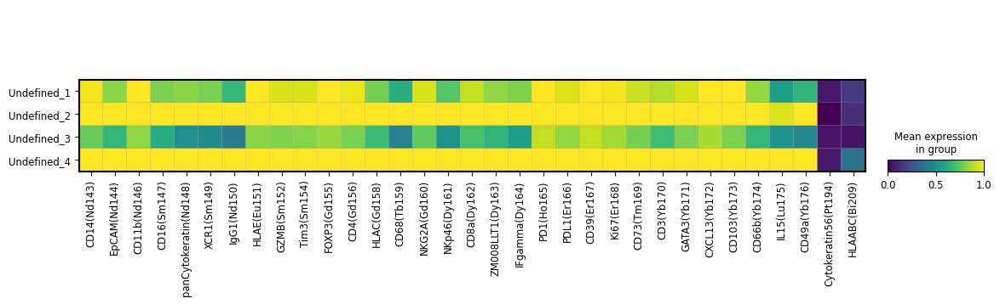

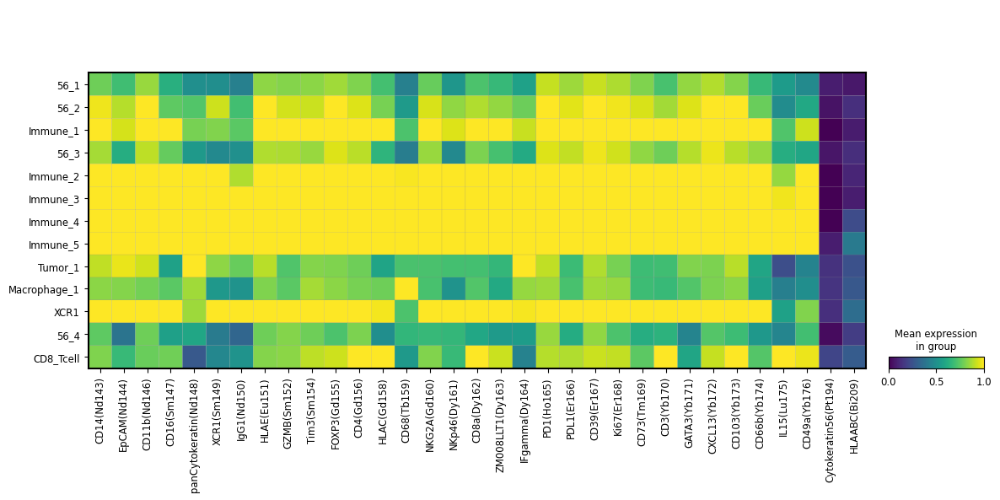

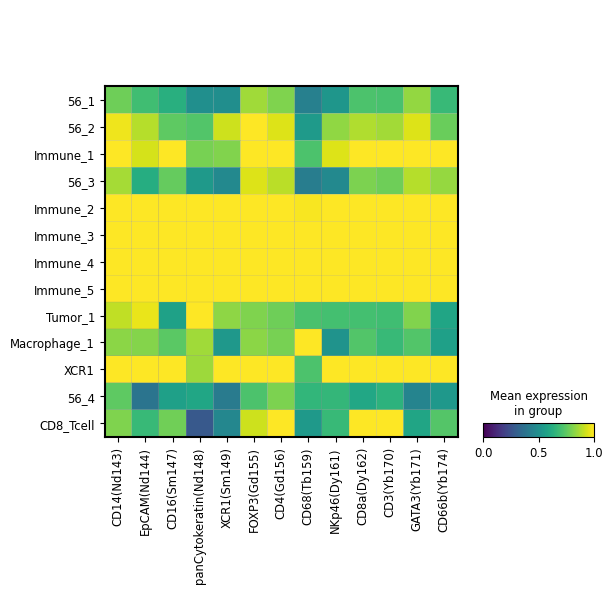

In [79]:
sc.pl.matrixplot(adata_Undefined, adata_Undefined.var_names, 'cluster_1',vmin =0, vmax=1)
sc.pl.matrixplot(adata_Undefined, adata_Undefined.var_names, 'cluster_2',vmin =0, vmax=1)
highly_variable_genes = adata_Undefined.var_names[adata_Undefined.var['highly_variable']]
sc.pl.matrixplot(adata_Undefined, highly_variable_genes, 'cluster_2',vmin =0, vmax=1)

In [89]:
adata_Undefined.obs['alt_name'] = adata_Undefined.obs['cluster_2']

In [90]:
adata_Undefined.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,cell_count,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name
230807_BCG01_Area3-01-0003,230807_BCG01_Area3,230807_BCG01_Area3-01,3,7.798246,71.236842,114.0,39.142136,10.735118,13.723384,0.622965,...,1534,1371_pre,pre,1371,cell_0,11,Undefined_1,Undefined,56_4,56_4
230807_BCG01_Area3-01-0006,230807_BCG01_Area3,230807_BCG01_Area3-01,6,11.088235,61.696078,102.0,37.384776,9.734949,13.614470,0.699079,...,1534,1371_pre,pre,1371,cell_3,4,Undefined_2,Undefined,Immune_2,Immune_2
230807_BCG01_Area3-01-0008,230807_BCG01_Area3,230807_BCG01_Area3-01,8,18.185022,103.365639,227.0,55.455844,14.444095,20.314560,0.703170,...,1534,1371_pre,pre,1371,cell_5,11,Undefined_3,Undefined,56_4,56_4
230807_BCG01_Area3-01-0009,230807_BCG01_Area3,230807_BCG01_Area3-01,9,18.239130,54.884058,138.0,44.384776,12.984671,14.109567,0.391274,...,1534,1371_pre,pre,1371,cell_6,8,Undefined_1,Undefined,Tumor_1,Tumor_1
230807_BCG01_Area3-01-0010,230807_BCG01_Area3,230807_BCG01_Area3-01,10,19.431953,89.875740,169.0,48.627417,13.208206,16.624382,0.607254,...,1534,1371_pre,pre,1371,cell_7,0,Undefined_3,Undefined,56_1,56_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-02-1846,BCG02_230627,BCG02_230627-02,1846,586.775701,405.803738,107.0,38.041631,10.548440,12.995355,0.584063,...,1772,2138_pre,pre,2138,cell_359460,5,Undefined_2,Undefined,Immune_3,Immune_3
BCG02_230627-02-1851,BCG02_230627,BCG02_230627-02,1851,588.811966,489.649573,234.0,64.698485,13.644144,23.949181,0.821844,...,1772,2138_pre,pre,2138,cell_359465,6,Undefined_2,Undefined,Immune_4,Immune_4
BCG02_230627-02-1853,BCG02_230627,BCG02_230627-02,1853,588.666667,363.047619,63.0,41.006097,8.502936,13.486513,0.776208,...,1772,2138_pre,pre,2138,cell_359467,4,Undefined_2,Undefined,Immune_2,Immune_2
BCG02_230627-02-1858,BCG02_230627,BCG02_230627-02,1858,592.353741,67.455782,147.0,46.041631,12.613173,15.517939,0.582526,...,1772,2138_pre,pre,2138,cell_359471,0,Undefined_3,Undefined,56_1,56_1


In [93]:
adata_Undefined_cluster_names = [
    '56_1', '56_2', 'Immune_1', '56_3',
    'Bright_1', 'Bright_2', 'Bright_3', 'Bright_4',
    'Tumor_1', 'Macrophage_1', 'XCR1', '56_4',
    'CD8_Tcell'] 
adata_Undefined.rename_categories('alt_name', adata_Undefined_cluster_names)

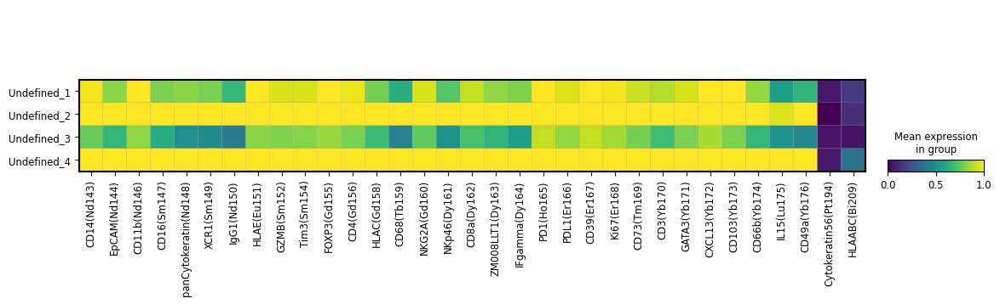

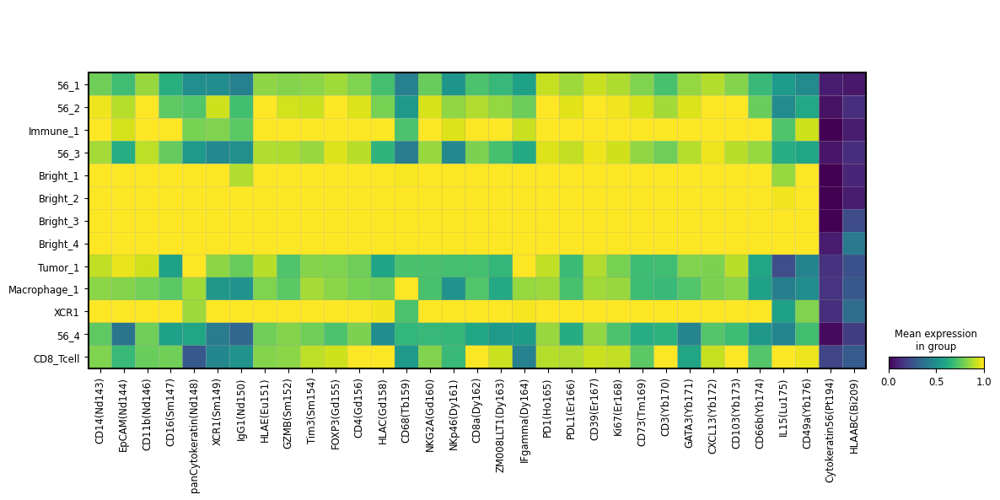

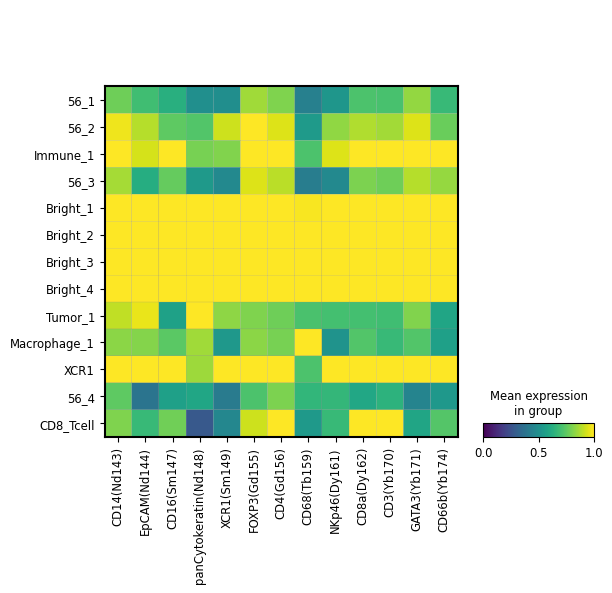

In [94]:
sc.pl.matrixplot(adata_Undefined, adata_Undefined.var_names, 'cluster_1',vmin =0, vmax=1)
sc.pl.matrixplot(adata_Undefined, adata_Undefined.var_names, 'alt_name',vmin =0, vmax=1)
highly_variable_genes = adata_Undefined.var_names[adata_Undefined.var['highly_variable']]
sc.pl.matrixplot(adata_Undefined, highly_variable_genes, 'alt_name',vmin =0, vmax=1)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


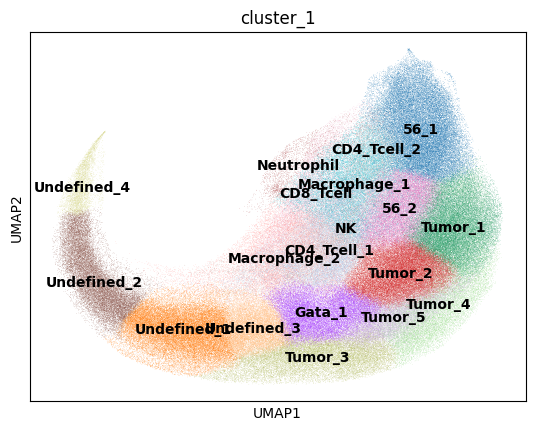

In [95]:
sc.pl.umap(adata, color=['cluster_1'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


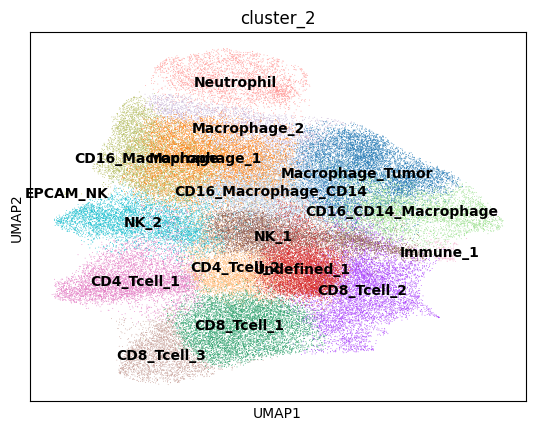

In [96]:
sc.pl.umap(adata_Immune, color=['cluster_2'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


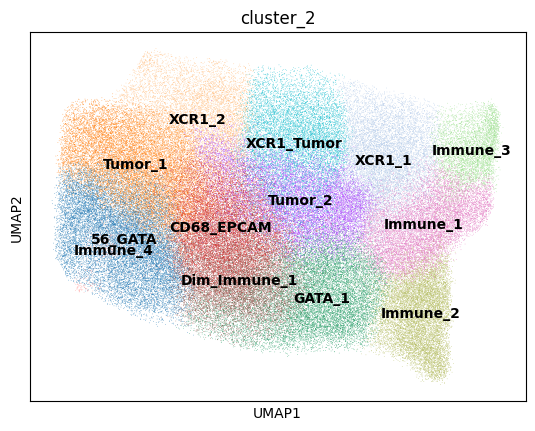

In [99]:
sc.pl.umap(adata_Tumor, color=['cluster_2'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


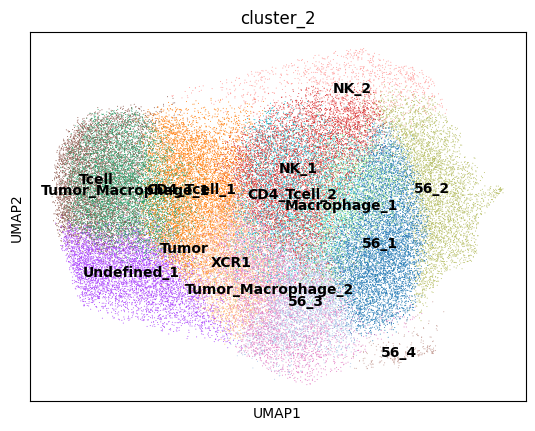

In [101]:
sc.pl.umap(adata_cluster_56, color=['cluster_2'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


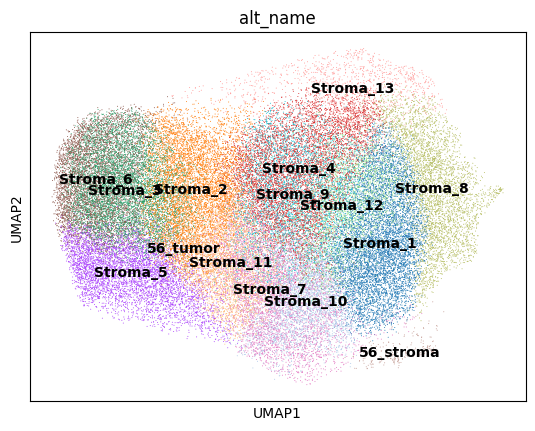

In [108]:
sc.pl.umap(adata_cluster_56, color=['alt_name'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


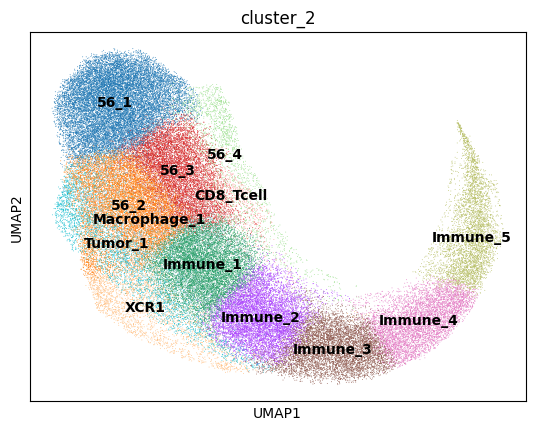

In [109]:
sc.pl.umap(adata_Undefined, color=['cluster_2'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


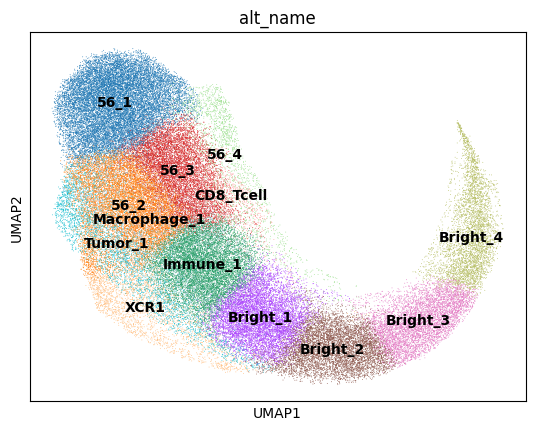

In [110]:
sc.pl.umap(adata_Undefined, color=['alt_name'],legend_loc='on data')

In [46]:
adata_Immune.write('adata_Immune.h5ad') 
adata_Tumor.write('adata_Tumor.h5ad') 
adata_cluster56.write('adata_cluster_56.h5ad') 
adata_Undefined.write('adata_Undefined.h5ad') 

In [47]:
adata_Immune = ad.read_h5ad('adata_Immune.h5ad') 
adata_Tumor = ad.read_h5ad('adata_Tumor.h5ad') 
adata_cluster56 = ad.read_h5ad('adata_cluster_56.h5ad') 
adata_Undefined = ad.read_h5ad('adata_Undefined.h5ad') 

In [57]:
adata_Immune

AnnData object with n_obs × n_vars = 80881 × 33
    obs: 'sample', 'roi', 'obj_id', 'X_centroid', 'Y_centroid', 'area', 'perimeter', 'minor_axis_length', 'major_axis_length', 'eccentricity', 'solidity', 'n_protein_by_counts', 'total_counts', 'cell_count', 'mob_id', 'pre_post', 'mob', 'cell_id', 'leiden', 'cluster_1', 'cluster_1_name', 'cluster_2'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'markers', 'channel', 'total_signal', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cluster_1_colors', 'cluster_1_name_colors', 'cluster_2_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'moved_genes', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'log', 'raw', 'z_scale'
    obsp: 'connectivities', 'distances'

In [53]:
adata

AnnData object with n_obs × n_vars = 360673 × 33
    obs: 'sample', 'roi', 'obj_id', 'X_centroid', 'Y_centroid', 'area', 'perimeter', 'minor_axis_length', 'major_axis_length', 'eccentricity', 'solidity', 'n_protein_by_counts', 'total_counts', 'cell_count', 'mob_id', 'pre_post', 'mob', 'cell_id', 'leiden', 'cluster_1', 'cluster_1_name'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'markers', 'channel', 'total_signal', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cluster_1_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'moved_genes', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'log', 'raw', 'z_scale'
    obsp: 'connectivities', 'distances'

In [114]:
concat =ad.concat([adata_Immune, adata_Tumor, adata_cluster_56, adata_Undefined], join = 'outer')


In [116]:
concat

AnnData object with n_obs × n_vars = 360673 × 33
    obs: 'sample', 'roi', 'obj_id', 'X_centroid', 'Y_centroid', 'area', 'perimeter', 'minor_axis_length', 'major_axis_length', 'eccentricity', 'solidity', 'n_protein_by_counts', 'total_counts', 'cell_count', 'mob_id', 'pre_post', 'mob', 'cell_id', 'leiden', 'cluster_1', 'cluster_1_name', 'cluster_2', 'alt_name'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap', 'spatial'
    layers: 'log', 'raw', 'z_scale'

In [115]:
concat.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,cell_count,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name
230807_BCG01_Area3-01-0012,230807_BCG01_Area3,230807_BCG01_Area3-01,12,24.406667,131.693333,150.0,44.627417,13.633235,14.264553,0.294206,...,1534,1371_pre,pre,1371,cell_9,10,CD4_Tcell_1,Immune,CD4_Tcell_2,NaN
230807_BCG01_Area3-01-0032,230807_BCG01_Area3,230807_BCG01_Area3-01,32,49.795812,173.078534,191.0,52.284271,12.445381,19.693758,0.775013,...,1534,1371_pre,pre,1371,cell_29,3,CD4_Tcell_1,Immune,Undefined_1,NaN
230807_BCG01_Area3-01-0039,230807_BCG01_Area3,230807_BCG01_Area3-01,39,55.183673,212.224490,196.0,51.455844,13.505077,18.497144,0.683322,...,1534,1371_pre,pre,1371,cell_36,6,CD4_Tcell_2,Immune,CD4_Tcell_1,NaN
230807_BCG01_Area3-01-0101,230807_BCG01_Area3,230807_BCG01_Area3-01,101,114.185714,161.671429,70.0,29.313708,8.488177,10.591787,0.598139,...,1534,1371_pre,pre,1371,cell_98,5,NK,Immune,NK_1,NaN
230807_BCG01_Area3-01-0103,230807_BCG01_Area3,230807_BCG01_Area3-01,103,115.078571,332.150000,140.0,43.556349,12.276599,14.732784,0.552845,...,1534,1371_pre,pre,1371,cell_100,1,Macrophage_1,Immune,Macrophage_1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-02-1846,BCG02_230627,BCG02_230627-02,1846,586.775701,405.803738,107.0,38.041631,10.548440,12.995355,0.584063,...,1772,2138_pre,pre,2138,cell_359460,5,Undefined_2,Undefined,Immune_3,Bright_2
BCG02_230627-02-1851,BCG02_230627,BCG02_230627-02,1851,588.811966,489.649573,234.0,64.698485,13.644144,23.949181,0.821844,...,1772,2138_pre,pre,2138,cell_359465,6,Undefined_2,Undefined,Immune_4,Bright_3
BCG02_230627-02-1853,BCG02_230627,BCG02_230627-02,1853,588.666667,363.047619,63.0,41.006097,8.502936,13.486513,0.776208,...,1772,2138_pre,pre,2138,cell_359467,4,Undefined_2,Undefined,Immune_2,Bright_1
BCG02_230627-02-1858,BCG02_230627,BCG02_230627-02,1858,592.353741,67.455782,147.0,46.041631,12.613173,15.517939,0.582526,...,1772,2138_pre,pre,2138,cell_359471,0,Undefined_3,Undefined,56_1,56_1


In [117]:
concat_secondcluster_names = pd.DataFrame(concat.obs[['cell_id','cluster_2', 'alt_name']])


In [118]:
concat_secondcluster_names

,cell_id,cluster_2,alt_name
230807_BCG01_Area3-01-0012,cell_9,CD4_Tcell_2,NaN
230807_BCG01_Area3-01-0032,cell_29,Undefined_1,NaN
230807_BCG01_Area3-01-0039,cell_36,CD4_Tcell_1,NaN
230807_BCG01_Area3-01-0101,cell_98,NK_1,NaN
230807_BCG01_Area3-01-0103,cell_100,Macrophage_1,NaN
...,...,...,...
BCG02_230627-02-1846,cell_359460,Immune_3,Bright_2
BCG02_230627-02-1851,cell_359465,Immune_4,Bright_3
BCG02_230627-02-1853,cell_359467,Immune_2,Bright_1
BCG02_230627-02-1858,cell_359471,56_1,56_1


In [119]:
concat_secondcluster_names.set_index('cell_id', inplace=True)
adata.obs = adata.obs.join(concat_secondcluster_names, on='cell_id')

In [120]:
adata

AnnData object with n_obs × n_vars = 360673 × 33
    obs: 'sample', 'roi', 'obj_id', 'X_centroid', 'Y_centroid', 'area', 'perimeter', 'minor_axis_length', 'major_axis_length', 'eccentricity', 'solidity', 'n_protein_by_counts', 'total_counts', 'cell_count', 'mob_id', 'pre_post', 'mob', 'cell_id', 'leiden', 'cluster_1', 'cluster_1_name', 'cluster_2', 'alt_name'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'markers', 'channel', 'total_signal', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cluster_1_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'moved_genes', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'log', 'raw', 'z_scale'
    obsp: 'connectivities', 'distances'

In [121]:
adata.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,cell_count,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name
230807_BCG01_Area3-01-0003,230807_BCG01_Area3,230807_BCG01_Area3-01,3,7.798246,71.236842,114.0,39.142136,10.735118,13.723384,0.622965,...,1534,1371_pre,pre,1371,cell_0,1,Undefined_1,Undefined,56_4,56_4
230807_BCG01_Area3-01-0004,230807_BCG01_Area3,230807_BCG01_Area3-01,4,8.207792,51.454545,77.0,31.313708,8.136043,12.088005,0.739581,...,1534,1371_pre,pre,1371,cell_1,2,Tumor_1,Tumor,Tumor_1,NaN
230807_BCG01_Area3-01-0005,230807_BCG01_Area3,230807_BCG01_Area3-01,5,9.715556,182.315556,225.0,57.112698,14.157603,20.908666,0.735876,...,1534,1371_pre,pre,1371,cell_2,3,Tumor_2,Tumor,CD68_EPCAM,NaN
230807_BCG01_Area3-01-0006,230807_BCG01_Area3,230807_BCG01_Area3-01,6,11.088235,61.696078,102.0,37.384776,9.734949,13.614470,0.699079,...,1534,1371_pre,pre,1371,cell_3,5,Undefined_2,Undefined,Immune_2,Bright_1
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,1534,1371_pre,pre,1371,cell_4,6,56_2,cluster_56,Undefined_1,Stroma_5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,1197,2138_pre,pre,2138,cell_360668,0,56_1,cluster_56,XCR1,Stroma_11
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,1197,2138_pre,pre,2138,cell_360669,6,56_2,cluster_56,CD4_Tcell_1,Stroma_2
BCG02_230627-03-1217,BCG02_230627,BCG02_230627-03,1217,593.483333,515.283333,60.0,26.727922,7.589057,10.055711,0.656069,...,1197,2138_pre,pre,2138,cell_360670,8,Macrophage_1,Immune,Macrophage_1,NaN
BCG02_230627-03-1218,BCG02_230627,BCG02_230627-03,1218,593.486486,552.540541,37.0,20.485281,5.884725,8.009470,0.678369,...,1197,2138_pre,pre,2138,cell_360671,0,56_1,cluster_56,Macrophage_1,Stroma_12


/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


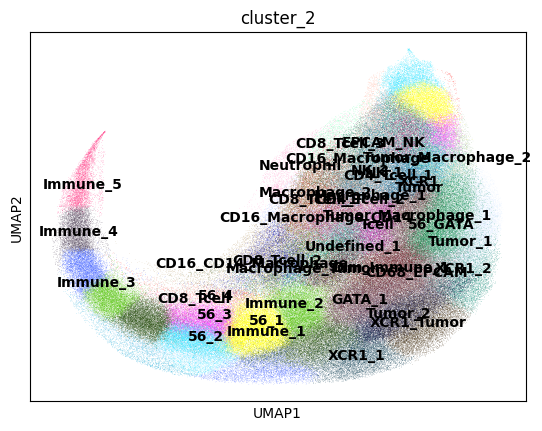

In [122]:
sc.pl.umap(adata, color=['cluster_2'],legend_loc='on data')

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


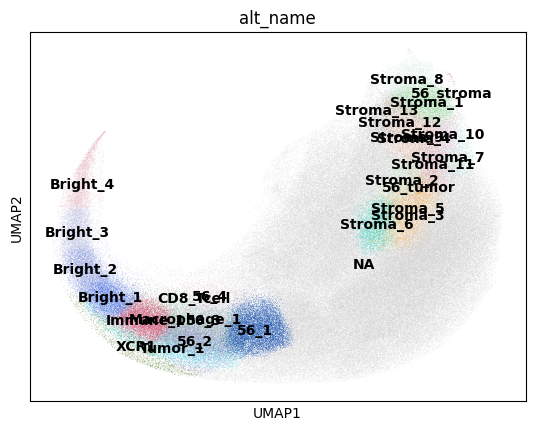

In [123]:
sc.pl.umap(adata, color=['alt_name'],legend_loc='on data')

In [68]:
adata.write('adata.h5ad') 


In [135]:
df_adata = pd.DataFrame(adata.obs[['leiden','sample','roi','area','total_counts','mob','mob_id','pre_post','cluster_2', 'alt_name']])


In [138]:
df_adata['alt_name'] = df_adata['alt_name'].astype(str)

In [136]:
df_adata['cluster_2'] = df_adata['cluster_2'].astype(str)

In [140]:
df_adata.replace('nan', np.nan, inplace=True)


In [141]:
df_adata['last_name'] = df_adata['alt_name'].fillna(df_adata['cluster_2'])


In [142]:
nan_indices = df_adata['alt_name'].isna()
print(nan_indices.any())

True


In [143]:
df_adata

,leiden,sample,roi,area,total_counts,mob,mob_id,pre_post,cluster_2,alt_name,last_name
230807_BCG01_Area3-01-0003,1,230807_BCG01_Area3,230807_BCG01_Area3-01,114.0,165.579940,1371,1371_pre,pre,56_4,56_4,56_4
230807_BCG01_Area3-01-0004,2,230807_BCG01_Area3,230807_BCG01_Area3-01,77.0,61.537973,1371,1371_pre,pre,Tumor_1,NaN,Tumor_1
230807_BCG01_Area3-01-0005,3,230807_BCG01_Area3,230807_BCG01_Area3-01,225.0,90.438201,1371,1371_pre,pre,CD68_EPCAM,NaN,CD68_EPCAM
230807_BCG01_Area3-01-0006,5,230807_BCG01_Area3,230807_BCG01_Area3-01,102.0,197.760229,1371,1371_pre,pre,Immune_2,Bright_1,Bright_1
230807_BCG01_Area3-01-0007,6,230807_BCG01_Area3,230807_BCG01_Area3-01,47.0,96.438094,1371,1371_pre,pre,Undefined_1,Stroma_5,Stroma_5
...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1214,0,BCG02_230627,BCG02_230627-03,66.0,40.670804,2138,2138_pre,pre,XCR1,Stroma_11,Stroma_11
BCG02_230627-03-1215,6,BCG02_230627,BCG02_230627-03,78.0,44.055914,2138,2138_pre,pre,CD4_Tcell_1,Stroma_2,Stroma_2
BCG02_230627-03-1217,8,BCG02_230627,BCG02_230627-03,60.0,36.300239,2138,2138_pre,pre,Macrophage_1,NaN,Macrophage_1
BCG02_230627-03-1218,0,BCG02_230627,BCG02_230627-03,37.0,24.827786,2138,2138_pre,pre,Macrophage_1,Stroma_12,Stroma_12


In [144]:
adata.obs['last_name'] = df_adata['last_name']


In [145]:
adata.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name,last_name
230807_BCG01_Area3-01-0003,230807_BCG01_Area3,230807_BCG01_Area3-01,3,7.798246,71.236842,114.0,39.142136,10.735118,13.723384,0.622965,...,1371_pre,pre,1371,cell_0,1,Undefined_1,Undefined,56_4,56_4,56_4
230807_BCG01_Area3-01-0004,230807_BCG01_Area3,230807_BCG01_Area3-01,4,8.207792,51.454545,77.0,31.313708,8.136043,12.088005,0.739581,...,1371_pre,pre,1371,cell_1,2,Tumor_1,Tumor,Tumor_1,NaN,Tumor_1
230807_BCG01_Area3-01-0005,230807_BCG01_Area3,230807_BCG01_Area3-01,5,9.715556,182.315556,225.0,57.112698,14.157603,20.908666,0.735876,...,1371_pre,pre,1371,cell_2,3,Tumor_2,Tumor,CD68_EPCAM,NaN,CD68_EPCAM
230807_BCG01_Area3-01-0006,230807_BCG01_Area3,230807_BCG01_Area3-01,6,11.088235,61.696078,102.0,37.384776,9.734949,13.614470,0.699079,...,1371_pre,pre,1371,cell_3,5,Undefined_2,Undefined,Immune_2,Bright_1,Bright_1
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,1371_pre,pre,1371,cell_4,6,56_2,cluster_56,Undefined_1,Stroma_5,Stroma_5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,2138_pre,pre,2138,cell_360668,0,56_1,cluster_56,XCR1,Stroma_11,Stroma_11
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,2138_pre,pre,2138,cell_360669,6,56_2,cluster_56,CD4_Tcell_1,Stroma_2,Stroma_2
BCG02_230627-03-1217,BCG02_230627,BCG02_230627-03,1217,593.483333,515.283333,60.0,26.727922,7.589057,10.055711,0.656069,...,2138_pre,pre,2138,cell_360670,8,Macrophage_1,Immune,Macrophage_1,NaN,Macrophage_1
BCG02_230627-03-1218,BCG02_230627,BCG02_230627-03,1218,593.486486,552.540541,37.0,20.485281,5.884725,8.009470,0.678369,...,2138_pre,pre,2138,cell_360671,0,56_1,cluster_56,Macrophage_1,Stroma_12,Stroma_12


In [147]:
second_cluster_all_names =(adata.obs['last_name'].unique())

In [148]:
for name in sorted(second_cluster_all_names):
    print(name)


56_1
56_2
56_3
56_4
56_GATA
56_stroma
56_tumor
Bright_1
Bright_2
Bright_3
Bright_4
CD16_CD14_Macrophage
CD16_Macrophage
CD16_Macrophage_CD14
CD4_Tcell_1
CD4_Tcell_2
CD68_EPCAM
CD8_Tcell
CD8_Tcell_1
CD8_Tcell_2
CD8_Tcell_3
Dim_Immune_1
EPCAM_NK
GATA_1
Immune_1
Immune_2
Immune_3
Immune_4
Macrophage_1
Macrophage_2
Macrophage_Tumor
NK_1
NK_2
Neutrophil
Stroma_1
Stroma_10
Stroma_11
Stroma_12
Stroma_13
Stroma_2
Stroma_3
Stroma_4
Stroma_5
Stroma_6
Stroma_7
Stroma_8
Stroma_9
Tumor_1
Tumor_2
Undefined_1
XCR1
XCR1_1
XCR1_2
XCR1_Tumor


In [3]:
adata = ad.read_h5ad("adata_6May_Label.h5ad")

In [4]:
concat_secondcluster_names = pd.DataFrame(adata.obs[['cell_id','last_name']])


In [5]:
concat_secondcluster_names

,cell_id,last_name
230807_BCG01_Area3-01-0003,cell_0,56_4
230807_BCG01_Area3-01-0004,cell_1,Tumor_1
230807_BCG01_Area3-01-0005,cell_2,CD68_EPCAM
230807_BCG01_Area3-01-0006,cell_3,Bright_1
230807_BCG01_Area3-01-0007,cell_4,Stroma_5
...,...,...
BCG02_230627-03-1214,cell_360668,Stroma_11
BCG02_230627-03-1215,cell_360669,Stroma_2
BCG02_230627-03-1217,cell_360670,Macrophage_1
BCG02_230627-03-1218,cell_360671,Stroma_12


In [6]:
mapping_dict = {
    "56_1":"56_Tumor",
    "56_2":"56_Tumor",
    "56_3":"56_Tumor",
    #CHANGED BELOW LINE FROM 
    #"56_4":"56",
    #TO 
    #"56_4":"56_Stroma",
    "56_4":"56_Stroma",
    "56_GATA":"56_Tumor",
    "56_stroma":"56_Stroma",
    "56_tumor":"56_Tumor",
    "Bright_1":"Bright",
    "Bright_2":"Bright",
    "Bright_3":"Bright",
    "Bright_4":"Bright",
    "CD16_CD14_Macrophage":"Macrophage",
    "CD16_Macrophage":"Macrophage",
    "CD16_Macrophage_CD14":"Macrophage",
    "CD4_Tcell_1":"CD4",
    "CD4_Tcell_2":"CD4",
    "CD68_EPCAM":"Macrophage",
    "CD8_Tcell":"CD8",
    "CD8_Tcell_1":"CD8",
    "CD8_Tcell_2":"CD8",
    "CD8_Tcell_3":"CD8",
    "Dim_Immune_1":"Dim immune",
    "EPCAM_NK":"Tumor",
    "GATA_1":"Tumor",
    "Immune_1":"Immune",
    "Immune_2":"Immune",
    "Immune_3":"Immune",
    "Immune_4":"Immune",
    "Macrophage_1":"Macrophage",
    "Macrophage_2":"Macrophage",
    #Old name 
    #"Macrophage_Tumor":"Macrophage",
    "Macrophage_Tumor":"Tumor",
    "NK_1":"NK",
    "NK_2":"NK",
    "Neutrophil":"Neutrophil",
    "Stroma_1":"Stroma",
    "Stroma_10":"Stroma",
    "Stroma_11":"Stroma",
    "Stroma_12":"Stroma",
    "Stroma_13":"Stroma",
    "Stroma_2":"Stroma",
    "Stroma_3":"Stroma",
    "Stroma_4":"Stroma",
    "Stroma_5":"Stroma",
    "Stroma_6":"Stroma",
    "Stroma_7":"Stroma",
    "Stroma_8":"Stroma",
    "Stroma_9":"Stroma",
    "Tumor_1":"Tumor",
    "Tumor_2":"Tumor",
    "Undefined_1":"Unknown",
    "XCR1":"DC",
    "XCR1_1":"DC",
    "XCR1_2":"DC",
    "XCR1_Tumor":"Tumor"
    
}


# Apply mappings to leiden_combined column
concat_secondcluster_names['last_name_simple'] = concat_secondcluster_names['last_name'].map(mapping_dict)

In [7]:
concat_secondcluster_names

,cell_id,last_name,last_name_simple
230807_BCG01_Area3-01-0003,cell_0,56_4,56_Stroma
230807_BCG01_Area3-01-0004,cell_1,Tumor_1,Tumor
230807_BCG01_Area3-01-0005,cell_2,CD68_EPCAM,Macrophage
230807_BCG01_Area3-01-0006,cell_3,Bright_1,Bright
230807_BCG01_Area3-01-0007,cell_4,Stroma_5,Stroma
...,...,...,...
BCG02_230627-03-1214,cell_360668,Stroma_11,Stroma
BCG02_230627-03-1215,cell_360669,Stroma_2,Stroma
BCG02_230627-03-1217,cell_360670,Macrophage_1,Macrophage
BCG02_230627-03-1218,cell_360671,Stroma_12,Stroma


In [8]:
adata.obs['last_name_simple'] = concat_secondcluster_names['last_name_simple']


In [9]:
adata.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,alt_name,last_name,last_name_simple
230807_BCG01_Area3-01-0003,230807_BCG01_Area3,230807_BCG01_Area3-01,3,7.798246,71.236842,114.0,39.142136,10.735118,13.723384,0.622965,...,pre,1371,cell_0,1,Undefined_1,Undefined,56_4,56_4,56_4,56_Stroma
230807_BCG01_Area3-01-0004,230807_BCG01_Area3,230807_BCG01_Area3-01,4,8.207792,51.454545,77.0,31.313708,8.136043,12.088005,0.739581,...,pre,1371,cell_1,2,Tumor_1,Tumor,Tumor_1,NaN,Tumor_1,Tumor
230807_BCG01_Area3-01-0005,230807_BCG01_Area3,230807_BCG01_Area3-01,5,9.715556,182.315556,225.0,57.112698,14.157603,20.908666,0.735876,...,pre,1371,cell_2,3,Tumor_2,Tumor,CD68_EPCAM,NaN,CD68_EPCAM,Macrophage
230807_BCG01_Area3-01-0006,230807_BCG01_Area3,230807_BCG01_Area3-01,6,11.088235,61.696078,102.0,37.384776,9.734949,13.614470,0.699079,...,pre,1371,cell_3,5,Undefined_2,Undefined,Immune_2,Bright_1,Bright_1,Bright
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,pre,1371,cell_4,6,56_2,cluster_56,Undefined_1,Stroma_5,Stroma_5,Stroma
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,pre,2138,cell_360668,0,56_1,cluster_56,XCR1,Stroma_11,Stroma_11,Stroma
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,pre,2138,cell_360669,6,56_2,cluster_56,CD4_Tcell_1,Stroma_2,Stroma_2,Stroma
BCG02_230627-03-1217,BCG02_230627,BCG02_230627-03,1217,593.483333,515.283333,60.0,26.727922,7.589057,10.055711,0.656069,...,pre,2138,cell_360670,8,Macrophage_1,Immune,Macrophage_1,NaN,Macrophage_1,Macrophage
BCG02_230627-03-1218,BCG02_230627,BCG02_230627-03,1218,593.486486,552.540541,37.0,20.485281,5.884725,8.009470,0.678369,...,pre,2138,cell_360671,0,56_1,cluster_56,Macrophage_1,Stroma_12,Stroma_12,Stroma


In [100]:
second_cluster_all_names_test =(concat_secondcluster_names['test'].unique())
second_cluster_all_names_test

array(['CD4_Tcell', 'Undefined', 'NK', 'Macrophage', 'Tumor', 'CD8_Tcell',
       'Neutrophil', 'cluster_56', 'XCR1'], dtype=object)

In [101]:
nan_values = concat_secondcluster_names['test'].isna()


In [102]:
num_nan_values = nan_values.sum()
print("Number of NaN values:", num_nan_values)


Number of NaN values: 0


In [103]:
rows_with_nan = concat_secondcluster_names[nan_values]
print(rows_with_nan)


Empty DataFrame
Columns: [cluster_2, test]
Index: []


In [104]:
second_cluster_all_names =(concat_secondcluster_names['test'].unique())
for name in sorted(second_cluster_all_names):
    print(name)


CD4_Tcell
CD8_Tcell
Macrophage
NK
Neutrophil
Tumor
Undefined
XCR1
cluster_56


In [105]:
concat_secondcluster_names

,cluster_2,test
cell_id,,
cell_9,CD4_Tcell_2,CD4_Tcell
cell_29,Undefined_1,Undefined
cell_36,CD4_Tcell_1,CD4_Tcell
cell_98,NK_1,NK
cell_100,Macrophage_1,Macrophage
...,...,...
cell_359460,Undefined_3,Undefined
cell_359465,Undefined_4,Undefined
cell_359467,Undefined_2,Undefined


In [106]:
# Assuming df is your DataFrame and 'old_name' is the current name of the column you want to change
#concat_secondcluster_names.rename(columns={'test': 'cluster_2_name'}, inplace=True)


In [107]:
concat_secondcluster_names 


,cluster_2,cluster_2_name
cell_id,,
cell_9,CD4_Tcell_2,CD4_Tcell
cell_29,Undefined_1,Undefined
cell_36,CD4_Tcell_1,CD4_Tcell
cell_98,NK_1,NK
cell_100,Macrophage_1,Macrophage
...,...,...
cell_359460,Undefined_3,Undefined
cell_359465,Undefined_4,Undefined
cell_359467,Undefined_2,Undefined


In [109]:
#concat_secondcluster_names.drop(columns=['cluster_2'], inplace=True)


In [110]:
concat_secondcluster_names

,cluster_2_name
cell_id,
cell_9,CD4_Tcell
cell_29,Undefined
cell_36,CD4_Tcell
cell_98,NK
cell_100,Macrophage
...,...
cell_359460,Undefined
cell_359465,Undefined
cell_359467,Undefined


In [112]:
concat_secondcluster_names.set_index('cell_id', inplace=True)
adata.obs = adata.obs.join(concat_secondcluster_names, on='cell_id')

In [113]:
adata.obs

,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,cell_count,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,cluster_2_name
230807_BCG01_Area3-01-0003,230807_BCG01_Area3,230807_BCG01_Area3-01,3,7.798246,71.236842,114.0,39.142136,10.735118,13.723384,0.622965,...,1534,1371_pre,pre,1371,cell_0,1,Undefined_1,Undefined,56_4,cluster_56
230807_BCG01_Area3-01-0004,230807_BCG01_Area3,230807_BCG01_Area3-01,4,8.207792,51.454545,77.0,31.313708,8.136043,12.088005,0.739581,...,1534,1371_pre,pre,1371,cell_1,2,Tumor_1,Tumor,Tumor_1,Tumor
230807_BCG01_Area3-01-0005,230807_BCG01_Area3,230807_BCG01_Area3-01,5,9.715556,182.315556,225.0,57.112698,14.157603,20.908666,0.735876,...,1534,1371_pre,pre,1371,cell_2,3,Tumor_2,Tumor,CD68_EPCAM,Macrophage
230807_BCG01_Area3-01-0006,230807_BCG01_Area3,230807_BCG01_Area3-01,6,11.088235,61.696078,102.0,37.384776,9.734949,13.614470,0.699079,...,1534,1371_pre,pre,1371,cell_3,5,Undefined_2,Undefined,Undefined_2,Undefined
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,1534,1371_pre,pre,1371,cell_4,6,56_2,cluster_56,Undefined_1,Undefined
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,1197,2138_pre,pre,2138,cell_360668,0,56_1,cluster_56,XCR1,XCR1
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,1197,2138_pre,pre,2138,cell_360669,6,56_2,cluster_56,CD4_Tcell_1,CD4_Tcell
BCG02_230627-03-1217,BCG02_230627,BCG02_230627-03,1217,593.483333,515.283333,60.0,26.727922,7.589057,10.055711,0.656069,...,1197,2138_pre,pre,2138,cell_360670,8,Macrophage_1,Immune,Macrophage_1,Macrophage
BCG02_230627-03-1218,BCG02_230627,BCG02_230627-03,1218,593.486486,552.540541,37.0,20.485281,5.884725,8.009470,0.678369,...,1197,2138_pre,pre,2138,cell_360671,0,56_1,cluster_56,Macrophage_1,Macrophage


/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


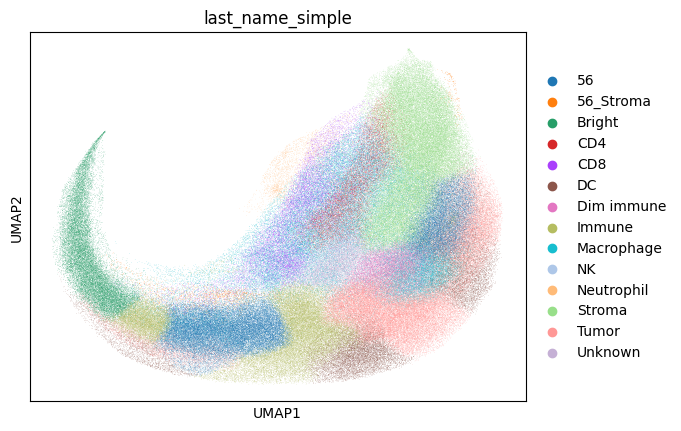

In [177]:
sc.pl.umap(adata, color=['last_name_simple'])

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


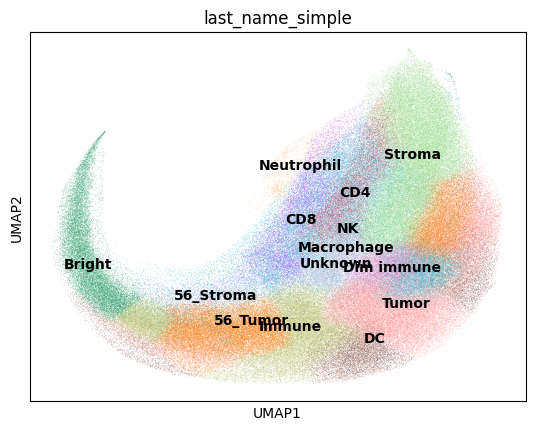

In [192]:
sc.pl.umap(adata, color=['last_name_simple'],legend_loc='on data')

In [10]:
adata.write('adata_6May_Label.h5ad') 

In [3]:
adata = ad.read_h5ad("adata_6May_Label.h5ad")


In [8]:
df_adata = pd.DataFrame(adata.obs[['leiden','sample','roi','area','total_counts','mob','mob_id','pre_post','cluster_2', 'last_name_simple']])


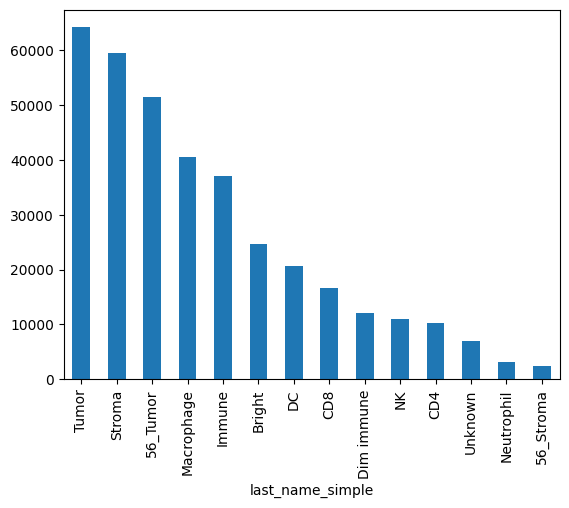

In [9]:
import matplotlib.pyplot as plt

df_adata['last_name_simple'].value_counts().plot(kind='bar')
plt.show()

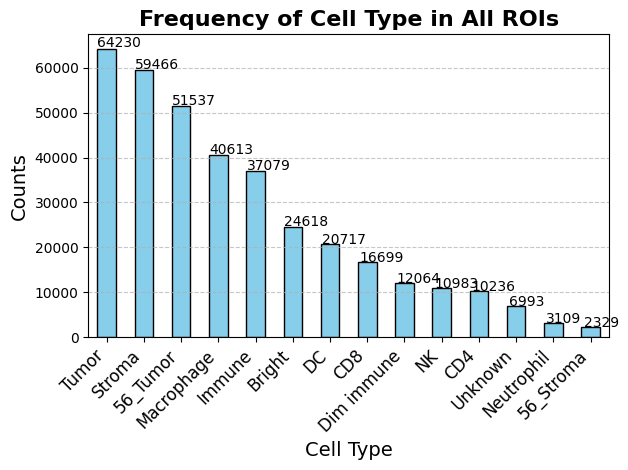

In [13]:
import matplotlib.pyplot as plt

# Plot the bar chart with value counts of 'last_name_simple'
ax = df_adata['last_name_simple'].value_counts().plot(kind='bar', color='skyblue', edgecolor='black')

# Add title and labels
ax.set_title('Frequency of Cell Type in All ROIs', fontsize=16, fontweight='bold')
ax.set_xlabel('Cell Type', fontsize=14)
ax.set_ylabel('Counts', fontsize=14)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right', fontsize=12)

# Add gridlines
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add numerical labels on top of the bars
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.005, p.get_height() * 1.005))

# Show the plot
plt.tight_layout()
plt.savefig('frequency.pdf')
plt.show()



/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_utils.py:429: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


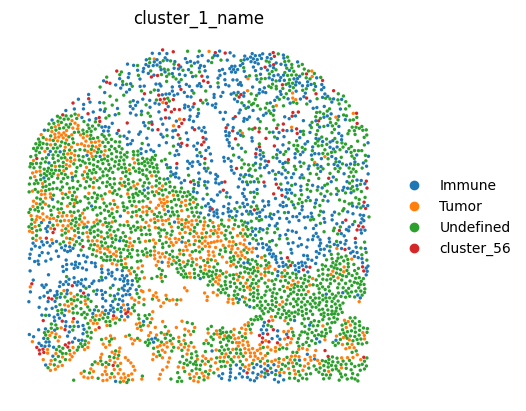

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_utils.py:429: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


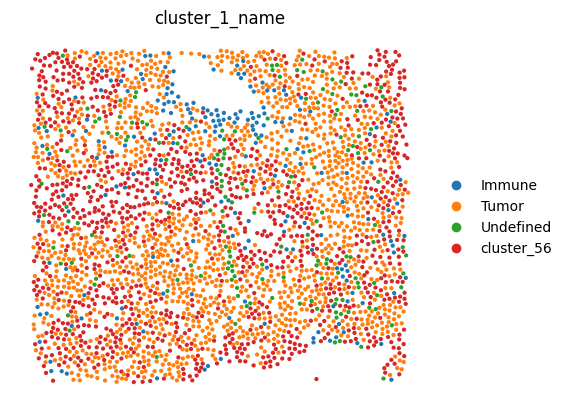

In [160]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_1_name",
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_1_name",
    frameon=False
)

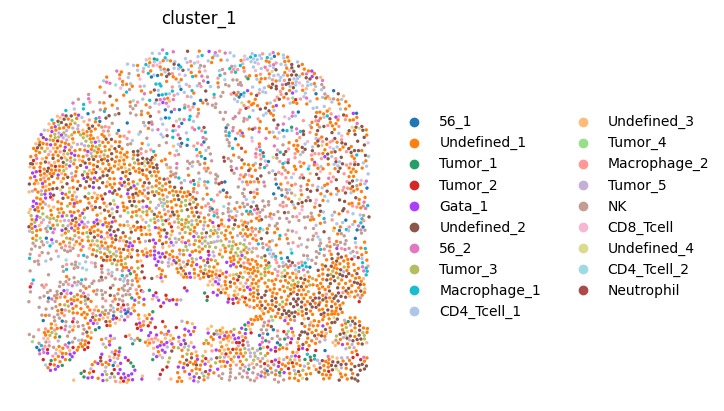

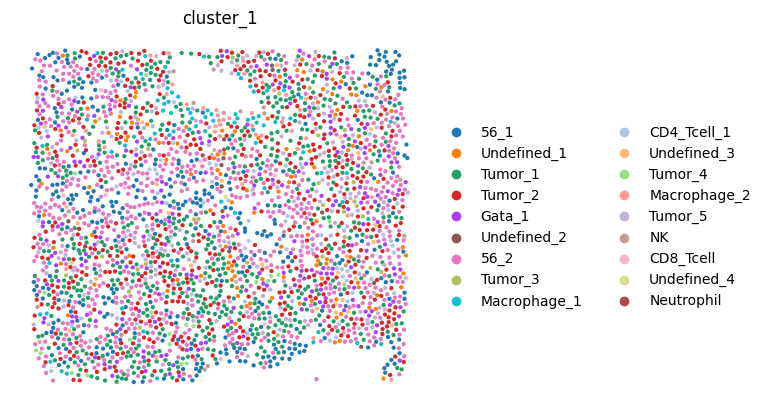

In [161]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_1",
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_1",
    frameon=False
)

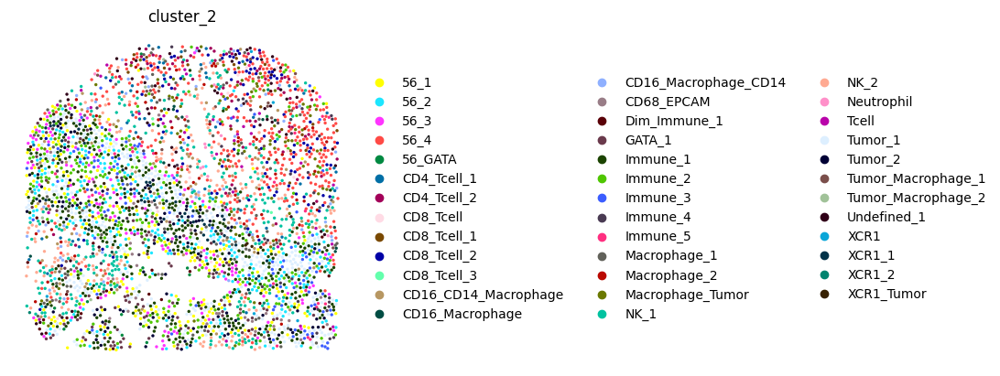

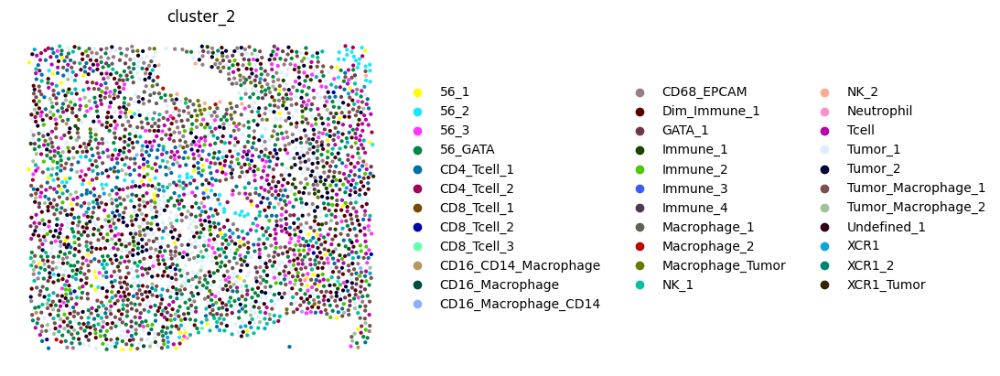

In [163]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_2",
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_2",
    frameon=False
)

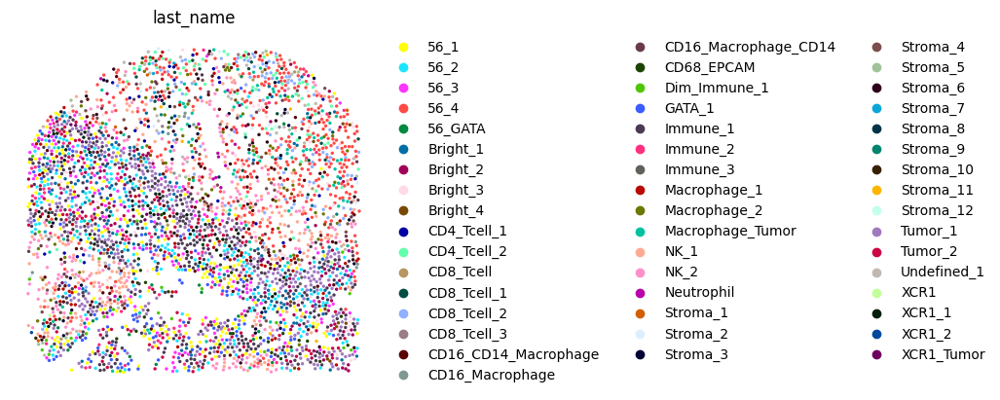

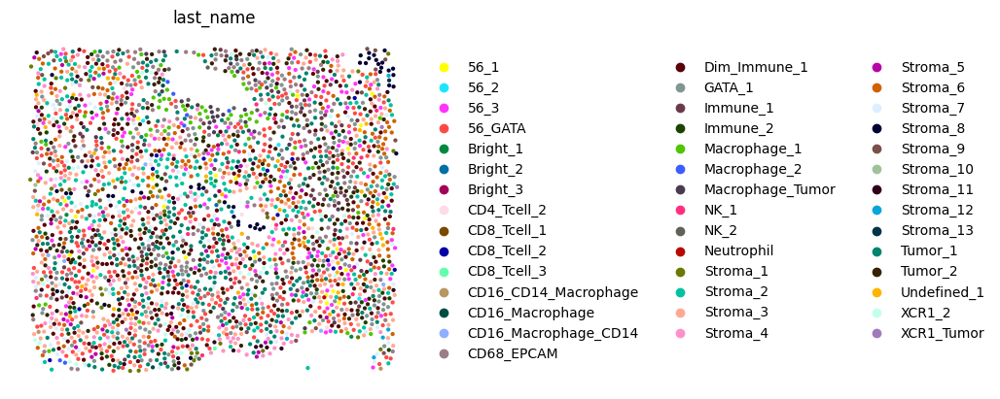

In [179]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="last_name",
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="last_name",
    frameon=False
)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_utils.py:429: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


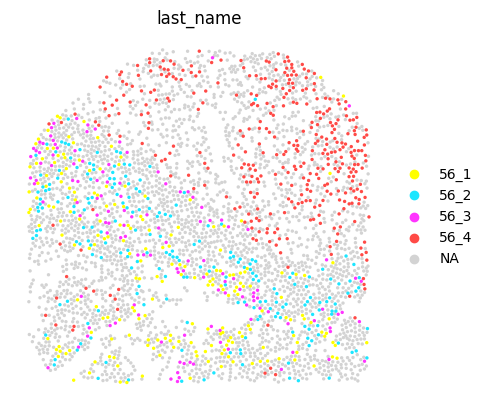

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_utils.py:429: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


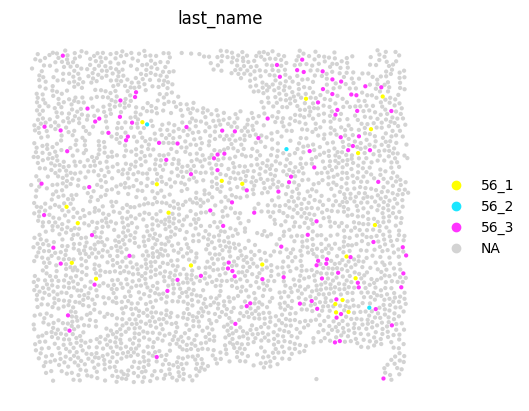

In [181]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="last_name",
    groups= ["56_1","56_2","56_3","56_4"],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="last_name",
    groups= ["56_1","56_2","56_3","56_4"],
    frameon=False
)

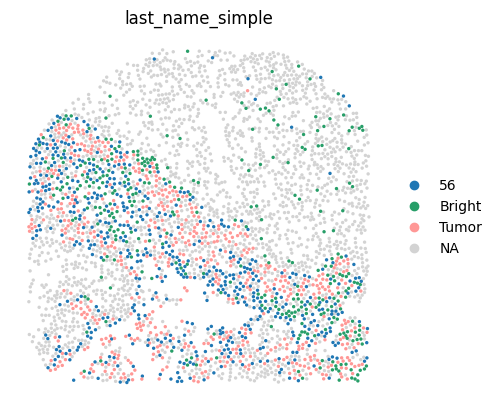

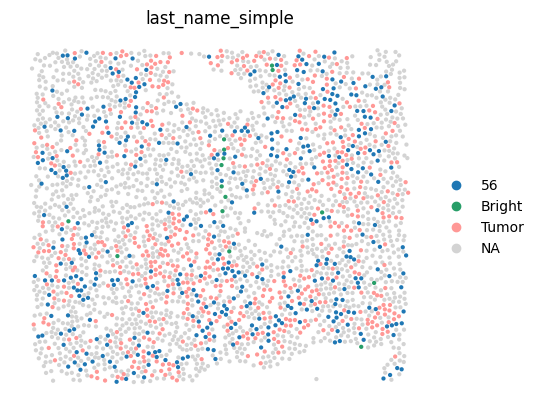

In [182]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="last_name_simple",
    groups=["56", "Bright", 'Tumor'],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="last_name_simple",
    groups=["56", "Bright", 'Tumor'],
    frameon=False
)

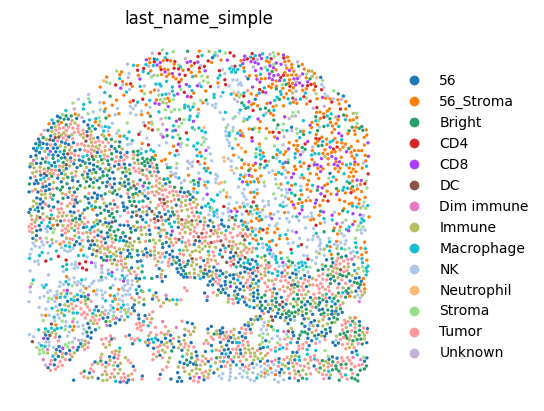

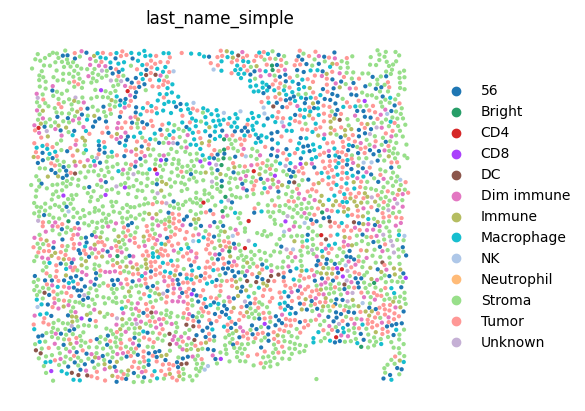

In [184]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="last_name_simple",
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="last_name_simple",
    frameon=False
)

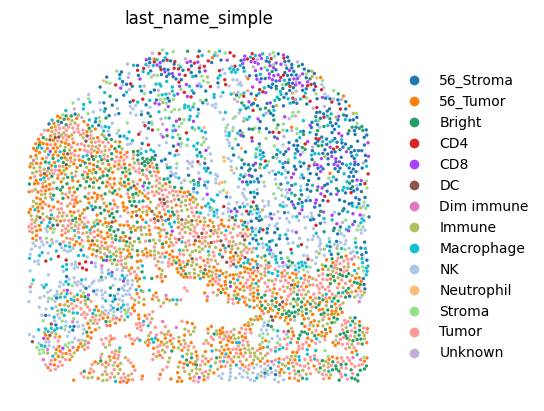

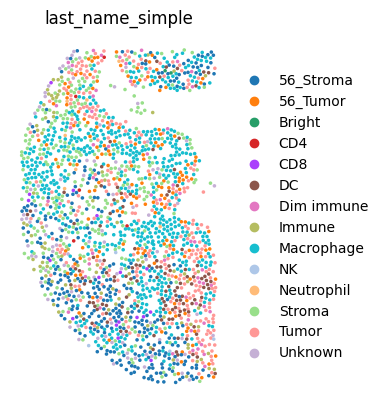

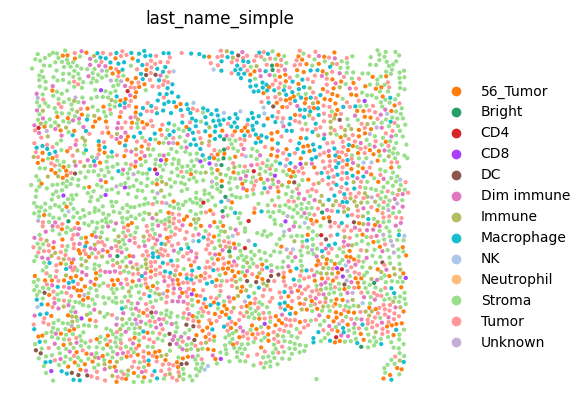

In [193]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']
roi_3 = ['230823_BCG04_Area6_continued_after_crash-14']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]
adata_roi_3 = adata [adata.obs['roi'].isin(roi_3)]


sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="last_name_simple",
   # groups=["56", "Bright", 'Tumor'],
    frameon=False
)

sc.pl.spatial(
    adata_roi_3,
    spot_size=10,
    color="last_name_simple",
   # groups=["56", "Bright", 'Tumor'],    
    frameon=False
)

sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="last_name_simple",
   # groups=["56", "Bright", 'Tumor'],    
    frameon=False
)

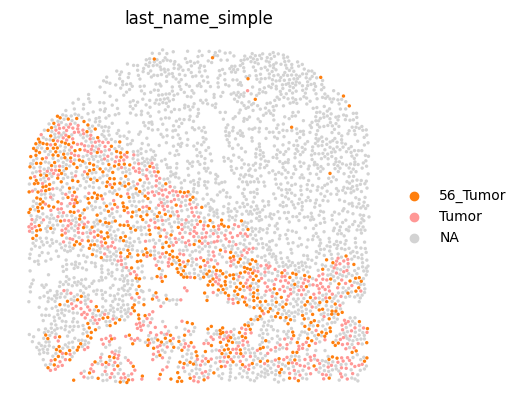

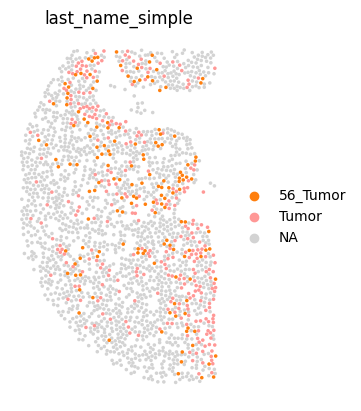

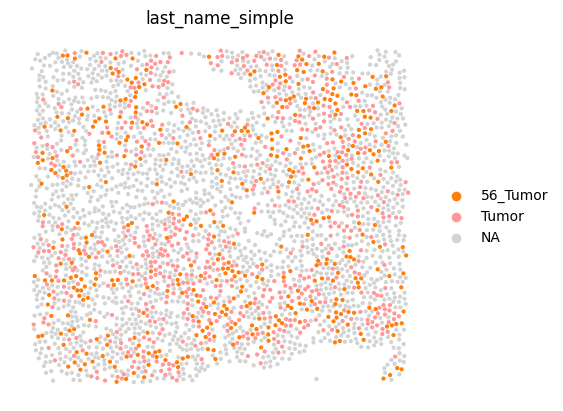

In [195]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

roi_3 = ['230823_BCG04_Area6_continued_after_crash-14']




adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]
adata_roi_3 = adata [adata.obs['roi'].isin(roi_3)]


sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="last_name_simple",
    groups=["56_Tumor", 'Tumor'],    
    frameon=False
)

sc.pl.spatial(
    adata_roi_3,
    spot_size=10,
    color="last_name_simple",
    groups=["56_Tumor", 'Tumor'],    
    frameon=False
)

sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="last_name_simple",
    groups=["56_Tumor", 'Tumor'],      
    frameon=False
)


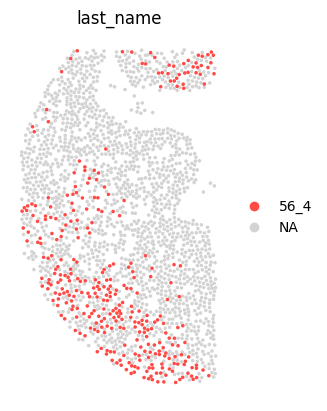

In [202]:
sc.pl.spatial(
    adata_roi_3,
    spot_size=10,
    color="last_name",
    groups=["56_4"],    
    frameon=False
)

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/anndata/_core/anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


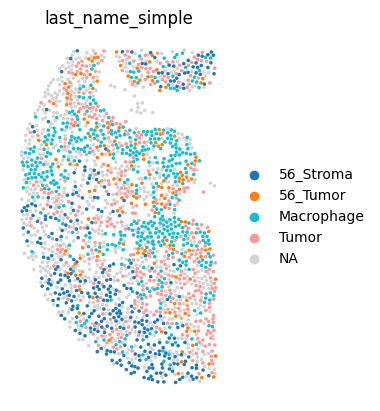

In [207]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

roi_3 = ['230823_BCG04_Area6_continued_after_crash-14']




adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]
adata_roi_3 = adata [adata.obs['roi'].isin(roi_3)]


sc.pl.spatial(
    adata_roi_3,
    spot_size=10,
    color="last_name_simple",
    groups=["56_Stroma", "56_Tumor", "Macrophage", "Tumor"],    
    frameon=False
)

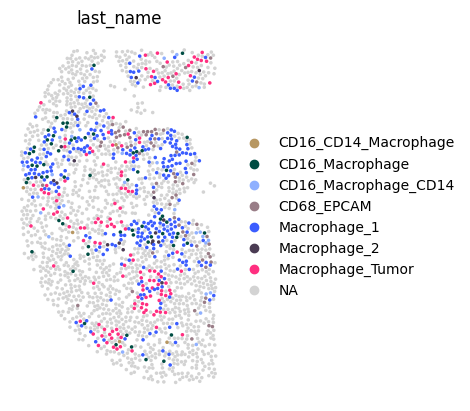

In [198]:
sc.pl.spatial(
    adata_roi_3,
    spot_size=10,
    color="last_name",
    groups=["CD16_CD14_Macrophage", "CD16_Macrophage_CD14", 'CD16_Macrophage', 'CD68_EPCAM', 'Macrophage_1', 'Macrophage_2', 'Macrophage_Tumor'],    
    frameon=False
)

In [125]:
import pandas as pd

# Assuming adata.obs is your DataFrame
adata.obs['cluster_2_name'] = adata.obs['cluster_2_name'].replace('Undefined', 'High_Signal')


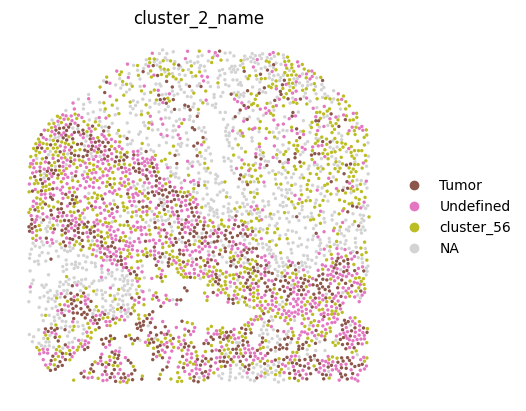

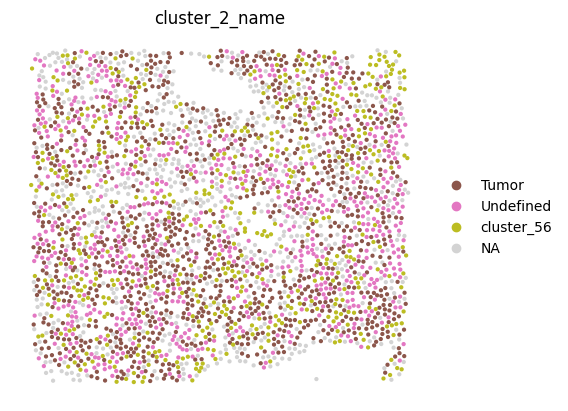

In [124]:

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_2_name",
    groups=["cluster_56", "Undefined", 'Tumor'],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_2_name",
    groups=["cluster_56", "Undefined", 'Tumor'],
    frameon=False
)

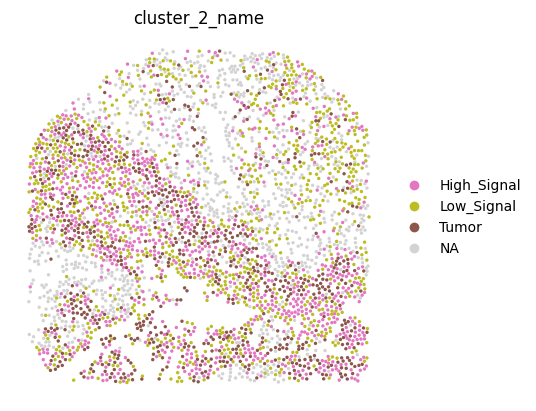

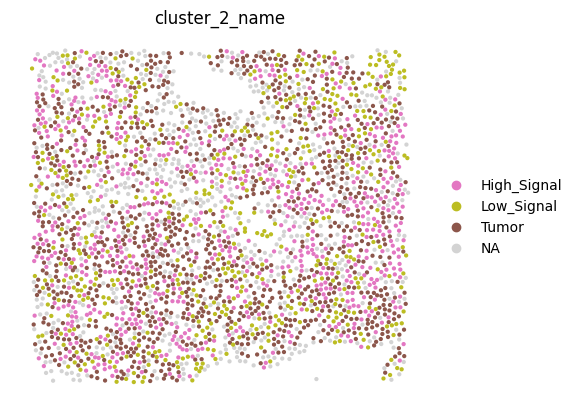

In [132]:
sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_2_name",
    groups=["Low_Signal", "High_Signal", 'Tumor'],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_2_name",
    groups=["Low_Signal", "High_Signal", 'Tumor'],
    frameon=False
)

In [129]:
adata.obs['cluster_2_name'] = adata.obs['cluster_2_name'].replace('cluster_56', 'Low_Signal')

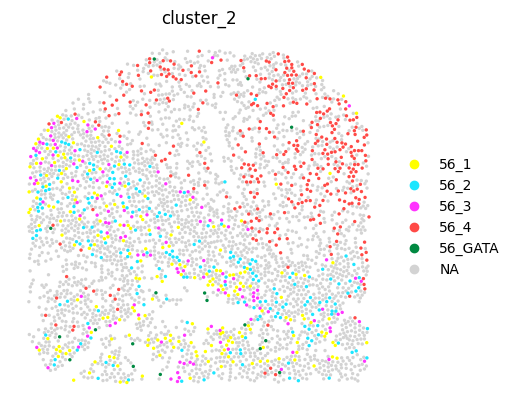

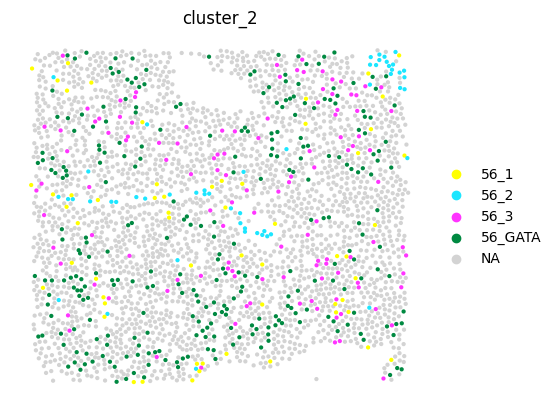

In [135]:
sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_2",
    groups=["56_1", "56_2", '56_3', '56_4', '56_GATA'],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_2",
    groups=["56_1", "56_2", '56_3', '56_4', '56_GATA'],
    frameon=False
)

In [143]:
concat_secondcluster_names = pd.DataFrame(concat.obs[['cell_id','cluster_2']])

mapping_dict = {
    "56_1": "cluster_56",
    "56_2": "cluster_56",
    "56_3": "cluster_56",
    "56_4": "STROMA",
    "56_GATA": "cluster_56",
    "CD16_CD14_Macrophage": "Macrophage",
    "CD16_Macrophage": "Macrophage",
    "CD16_Macrophage_CD14": "Macrophage",
    "CD68_EPCAM": "Macrophage",
    "CD4_Tcell": "CD4_Tcell",    
    "CD4_Tcell_1": "CD4_Tcell",
    "CD4_Tcell_2": "CD4_Tcell",
    "CD8_Tcell": "CD8_Tcell",
    "CD8_Tcell_1": "CD8_Tcell",
    "CD8_Tcell_2": "CD8_Tcell",
    "CD8_Tcell_3": "CD8_Tcell",
    "EPCAM_NK": "Tumor",
    "GATA_1": "Tumor",
    "Immune_Tumor": "Tumor",
    "Macrophage_1": "Macrophage",
    "Macrophage_2": "Macrophage",
    "Macrophage_Tumor": "Tumor",
    "Macrophage_Tumor_1": "Tumor",
    "Macrophage_Tumor_2": "Tumor",
    "NK_1": "NK",
    "NK_2": "NK",
    "Neutrophil": "Neutrophil",
    "Tumor_1": "Tumor",
    "Tumor_2": "Tumor",
    "Undefined_1": "Undefined",
    "Undefined_2": "Undefined",
    "Undefined_3": "Undefined",
    "Undefined_4": "Undefined",
    "Undefined_5": "Undefined",
    "XCR1": "XCR1",
    "XCR1_tumor": "XCR1",
    "XCR1_Tumor": "XCR1", 
    "XCR1_Immune": "XCR1", 
    
}


# Apply mappings to leiden_combined column
concat_secondcluster_names['test'] = concat_secondcluster_names['cluster_2'].map(mapping_dict)

In [144]:
concat_secondcluster_names

,cell_id,cluster_2,test
230807_BCG01_Area3-01-0012,cell_9,CD4_Tcell_2,CD4_Tcell
230807_BCG01_Area3-01-0032,cell_29,Undefined_1,Undefined
230807_BCG01_Area3-01-0039,cell_36,CD4_Tcell_1,CD4_Tcell
230807_BCG01_Area3-01-0101,cell_98,NK_1,NK
230807_BCG01_Area3-01-0103,cell_100,Macrophage_1,Macrophage
...,...,...,...
BCG02_230627-02-1846,cell_359460,Undefined_3,Undefined
BCG02_230627-02-1851,cell_359465,Undefined_4,Undefined
BCG02_230627-02-1853,cell_359467,Undefined_2,Undefined
BCG02_230627-02-1858,cell_359471,56_1,cluster_56


In [145]:
concat_secondcluster_names.drop(columns=['cluster_2'], inplace=True)


In [146]:
concat_secondcluster_names

,cell_id,test
230807_BCG01_Area3-01-0012,cell_9,CD4_Tcell
230807_BCG01_Area3-01-0032,cell_29,Undefined
230807_BCG01_Area3-01-0039,cell_36,CD4_Tcell
230807_BCG01_Area3-01-0101,cell_98,NK
230807_BCG01_Area3-01-0103,cell_100,Macrophage
...,...,...
BCG02_230627-02-1846,cell_359460,Undefined
BCG02_230627-02-1851,cell_359465,Undefined
BCG02_230627-02-1853,cell_359467,Undefined
BCG02_230627-02-1858,cell_359471,cluster_56


In [148]:
concat_secondcluster_names.set_index('cell_id', inplace=True)
adata.obs = adata.obs.join(concat_secondcluster_names, on='cell_id')

In [149]:
adata.obs


,sample,roi,obj_id,X_centroid,Y_centroid,area,perimeter,minor_axis_length,major_axis_length,eccentricity,...,mob_id,pre_post,mob,cell_id,leiden,cluster_1,cluster_1_name,cluster_2,cluster_2_name,test
230807_BCG01_Area3-01-0003,230807_BCG01_Area3,230807_BCG01_Area3-01,3,7.798246,71.236842,114.0,39.142136,10.735118,13.723384,0.622965,...,1371_pre,pre,1371,cell_0,1,Undefined_1,Undefined,56_4,Low_Signal,STROMA
230807_BCG01_Area3-01-0004,230807_BCG01_Area3,230807_BCG01_Area3-01,4,8.207792,51.454545,77.0,31.313708,8.136043,12.088005,0.739581,...,1371_pre,pre,1371,cell_1,2,Tumor_1,Tumor,Tumor_1,Tumor,Tumor
230807_BCG01_Area3-01-0005,230807_BCG01_Area3,230807_BCG01_Area3-01,5,9.715556,182.315556,225.0,57.112698,14.157603,20.908666,0.735876,...,1371_pre,pre,1371,cell_2,3,Tumor_2,Tumor,CD68_EPCAM,Macrophage,Macrophage
230807_BCG01_Area3-01-0006,230807_BCG01_Area3,230807_BCG01_Area3-01,6,11.088235,61.696078,102.0,37.384776,9.734949,13.614470,0.699079,...,1371_pre,pre,1371,cell_3,5,Undefined_2,Undefined,Undefined_2,High_Signal,Undefined
230807_BCG01_Area3-01-0007,230807_BCG01_Area3,230807_BCG01_Area3-01,7,13.978723,129.063830,47.0,23.071068,7.488948,8.022086,0.358470,...,1371_pre,pre,1371,cell_4,6,56_2,cluster_56,Undefined_1,High_Signal,Undefined
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BCG02_230627-03-1214,BCG02_230627,BCG02_230627-03,1214,590.393939,426.257576,66.0,27.556349,8.102249,10.346567,0.621914,...,2138_pre,pre,2138,cell_360668,0,56_1,cluster_56,XCR1,XCR1,XCR1
BCG02_230627-03-1215,BCG02_230627,BCG02_230627-03,1215,591.756410,491.487179,78.0,30.142136,9.598018,10.335545,0.370978,...,2138_pre,pre,2138,cell_360669,6,56_2,cluster_56,CD4_Tcell_1,CD4_Tcell,CD4_Tcell
BCG02_230627-03-1217,BCG02_230627,BCG02_230627-03,1217,593.483333,515.283333,60.0,26.727922,7.589057,10.055711,0.656069,...,2138_pre,pre,2138,cell_360670,8,Macrophage_1,Immune,Macrophage_1,Macrophage,Macrophage
BCG02_230627-03-1218,BCG02_230627,BCG02_230627-03,1218,593.486486,552.540541,37.0,20.485281,5.884725,8.009470,0.678369,...,2138_pre,pre,2138,cell_360671,0,56_1,cluster_56,Macrophage_1,Macrophage,Macrophage


/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/anndata/_core/anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


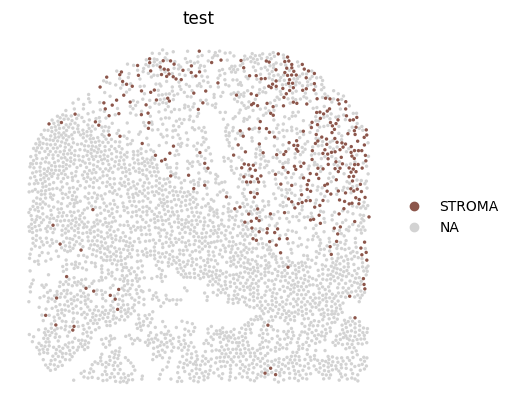

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/anndata/_core/anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


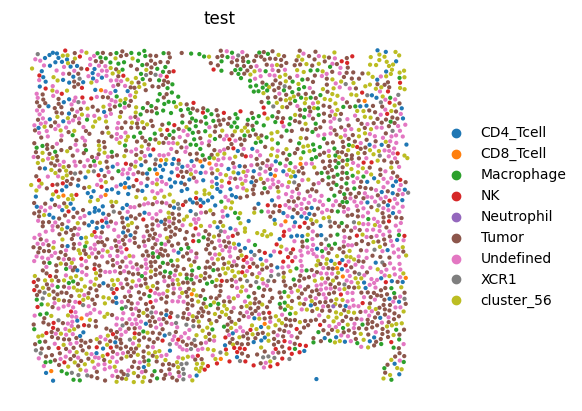

In [152]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="test",
    groups=["STROMA"],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="test",
    #groups=["56_1", "56_2", '56_3', '56_4', '56_GATA'],
    frameon=False
)

In [157]:
adata.obs.cluster_1.value_counts()
adata.obs.test.value_counts()


test
Undefined     90577
Tumor         67033
cluster_56    65781
Macrophage    41131
XCR1          34838
CD4_Tcell     20798
NK            18378
CD8_Tcell     16699
Neutrophil     3109
STROMA         2329
Name: count, dtype: int64

In [158]:
adata.write('adata_test.h5ad') 

In [171]:
# Filter the data for cells belonging to the 'Undefined_Immune' leiden observation
Stroma = ['56_4']
Stroma = adata [adata.obs['last_name'].isin(Stroma)]

# Get unique ROIs for these cells
unique_rois_for_Stroma = Stroma.obs['roi'].unique()

# Initialize a dictionary to store the proportion of cells in '0' leiden category per ROI
roi_cell_proportions = {}

# Iterate over unique ROIs for the 'marker' leiden observation
for roi in unique_rois_for_Stroma:
    # Filter the cells belonging to 'Undefined_Immune' leiden observations and the current ROI
    cells_in_roi = Stroma[Stroma.obs['roi'] == roi]
    # Get the count of cells for the current ROI
    cell_count_in_roi = len(cells_in_roi)
    # Get the total number of cells in the current ROI
    total_cell_count_in_roi = len(adata[adata.obs['roi'] == roi])
    # Calculate the proportion of cells in 'undefined_immune' leiden category relative to the total number of cells in the ROI
    proportion = cell_count_in_roi / total_cell_count_in_roi
    # Store the proportion of cells for the current ROI in the dictionary
    roi_cell_proportions[roi] = proportion

# Sort the dictionary by value (proportion) in descending order
sorted_roi_cell_proportions = {k: v for k, v in sorted(roi_cell_proportions.items(), key=lambda item: item[1], reverse=True)}

# Print the proportion of cells in 'undefined_immune' leiden observation relative to the total number of cells in each ROI
print("Proportion of cells in 'Stroma' leiden observation relative to total cells per ROI (sorted by proportion):")
for roi, proportion in sorted_roi_cell_proportions.items():
    print(f"ROI: {roi}, Proportion of Cells in 'Stroma' leiden observation: {proportion:.2f}")

Proportion of cells in 'Stroma' leiden observation relative to total cells per ROI (sorted by proportion):
ROI: 230823_BCG04_Area6_continued_after_crash-14, Proportion of Cells in 'Stroma' leiden observation: 0.16
ROI: 230807_BCG01_Area3-03, Proportion of Cells in 'Stroma' leiden observation: 0.10
ROI: 230807_BCG01_Area3-05, Proportion of Cells in 'Stroma' leiden observation: 0.08
ROI: 230817_BCG03_Area5andArea6-01, Proportion of Cells in 'Stroma' leiden observation: 0.07
ROI: 230823_BCG04_Area6-08, Proportion of Cells in 'Stroma' leiden observation: 0.05
ROI: 230823_BCG04_Area6_continued_after_crash-08, Proportion of Cells in 'Stroma' leiden observation: 0.05
ROI: 230822_BCG04_Area4andArea5andArea3-16, Proportion of Cells in 'Stroma' leiden observation: 0.04
ROI: 230807_BCG01_Area3-04, Proportion of Cells in 'Stroma' leiden observation: 0.03
ROI: 230821_BCG04_Area01andArea2-13, Proportion of Cells in 'Stroma' leiden observation: 0.03
ROI: 230823_BCG04_Area6-01, Proportion of Cells in 

In [172]:

# Create a list of tuples containing ROI name and cell count
roi_cell_counts = []
for roi in unique_rois_for_Stroma:
    cells_in_roi = Stroma[Stroma.obs['roi'] == roi]
    cell_count_in_roi = len(cells_in_roi)
    roi_cell_counts.append((roi, cell_count_in_roi))

# Sort the list of tuples based on the cell count (second element of the tuple)
sorted_roi_cell_counts = sorted(roi_cell_counts, key=lambda x: x[1], reverse= True)

# Print the sorted ROI names and corresponding cell counts
for roi, cell_count in sorted_roi_cell_counts:
    print(f"ROI: {roi}, Cell Count: {cell_count}")


ROI: 230807_BCG01_Area3-03, Cell Count: 372
ROI: 230823_BCG04_Area6_continued_after_crash-14, Cell Count: 328
ROI: 230817_BCG03_Area5andArea6-01, Cell Count: 171
ROI: 230823_BCG04_Area6-08, Cell Count: 136
ROI: 230823_BCG04_Area6_continued_after_crash-08, Cell Count: 136
ROI: 230822_BCG04_Area4andArea5andArea3-16, Cell Count: 92
ROI: 230821_BCG04_Area01andArea2-13, Cell Count: 71
ROI: 230823_BCG04_Area6-01, Cell Count: 65
ROI: 230823_BCG04_Area6_continued_after_crash-01, Cell Count: 65
ROI: 230807_BCG01_Area3-04, Cell Count: 63
ROI: 230807_BCG01_Area3-05, Cell Count: 44
ROI: 230810_BCG02_Area2-01, Cell Count: 43
ROI: 230821_BCG04_Area01andArea2-16, Cell Count: 35
ROI: 230823_BCG04_Area6-07, Cell Count: 33
ROI: 230823_BCG04_Area6_continued_after_crash-07, Cell Count: 33
ROI: 230809_BCG02_Area1-01, Cell Count: 32
ROI: 230807_BCG01_Area3-06, Cell Count: 24
ROI: 230815_BCG03_Area1-08, Cell Count: 24
ROI: 230816_BCG03_Area3andArea4-07, Cell Count: 22
ROI: 230807_BCG01_Area3-01, Cell Count: 

In [174]:
adata.obs['test'] = adata.obs['test'].replace('Undefined', 'High_Signal')
adata.obs['test'] = adata.obs['test'].replace('cluster_56', 'Low_Signal')


/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_utils.py:429: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


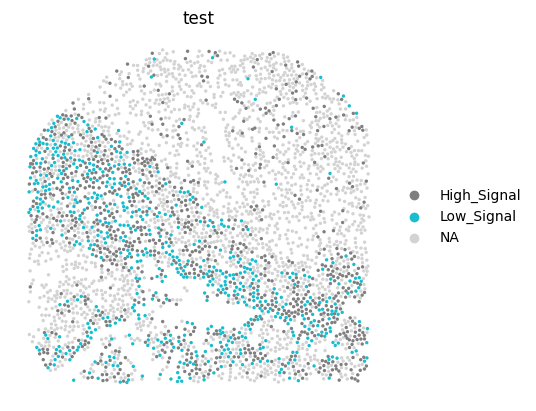

/home/tessdiv/miniconda3/envs/imc/lib/python3.11/site-packages/scanpy/plotting/_utils.py:429: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


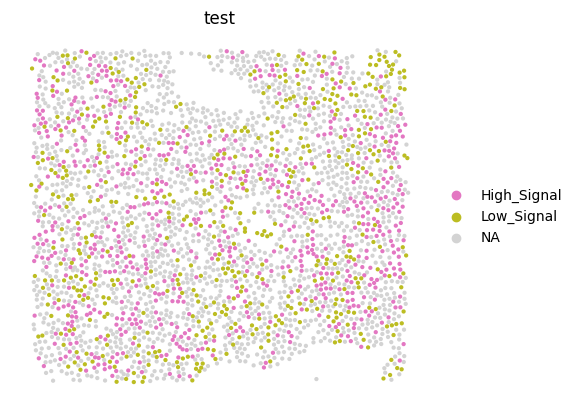

In [183]:
roi_1 = ['230807_BCG01_Area3-03']
roi_2 = ['230821_BCG04_Area01andArea2-06']

adata_roi_1 = adata [adata.obs['roi'].isin(roi_1)]
adata_roi_2 = adata [adata.obs['roi'].isin(roi_2)]

sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="test",
    groups=["Low_Signal", 'High_Signal'],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="test",
    groups=["Low_Signal", 'High_Signal'],
    frameon=False
)

In [176]:
adata.write('adata_test.h5ad') 

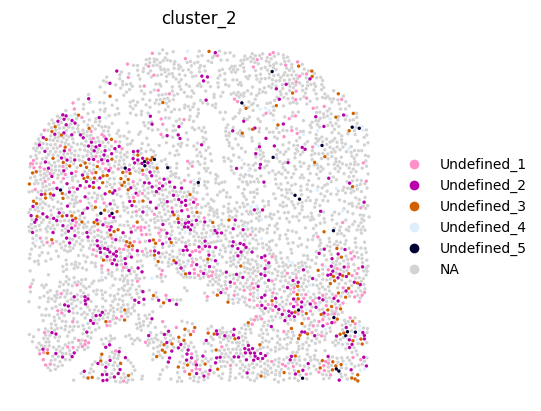

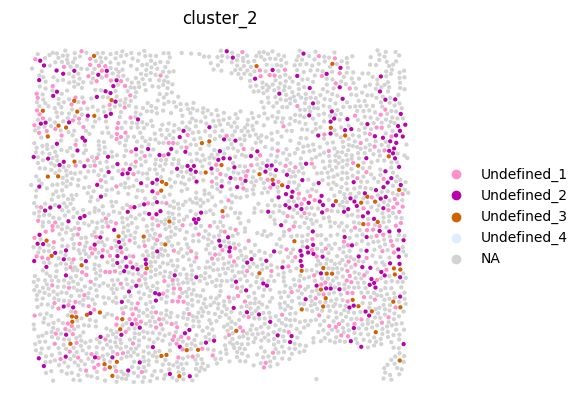

In [179]:
sc.pl.spatial(
    adata_roi_1,
    spot_size=10,
    color="cluster_2",
    groups=["Undefined_1", "Undefined_2", 'Undefined_3', 'Undefined_4', 'Undefined_5'],
    frameon=False
)
sc.pl.spatial(
    adata_roi_2,
    spot_size=10,
    color="cluster_2",
    groups=["Undefined_1", "Undefined_2", 'Undefined_3', 'Undefined_4', 'Undefined_5'],
    frameon=False
)

In [181]:
# Filter the data for cells belonging to the 'Undefined_Immune' leiden observation
High_Signal = ['High_Signal']
High_Signal = adata [adata.obs['test'].isin(High_Signal)]

# Get unique ROIs for these cells
unique_rois_for_High_Signal = High_Signal.obs['roi'].unique()

# Initialize a dictionary to store the proportion of cells in '0' leiden category per ROI
roi_cell_proportions = {}

# Iterate over unique ROIs for the 'marker' leiden observation
for roi in unique_rois_for_High_Signal:
    # Filter the cells belonging to 'High_Signal' leiden observations and the current ROI
    cells_in_roi = High_Signal[High_Signal.obs['roi'] == roi]
    # Get the count of cells for the current ROI
    cell_count_in_roi = len(cells_in_roi)
    # Get the total number of cells in the current ROI
    total_cell_count_in_roi = len(adata[adata.obs['roi'] == roi])
    # Calculate the proportion of cells in 'undefined_immune' leiden category relative to the total number of cells in the ROI
    proportion = cell_count_in_roi / total_cell_count_in_roi
    # Store the proportion of cells for the current ROI in the dictionary
    roi_cell_proportions[roi] = proportion

# Sort the dictionary by value (proportion) in descending order
sorted_roi_cell_proportions = {k: v for k, v in sorted(roi_cell_proportions.items(), key=lambda item: item[1], reverse=True)}

# Print the proportion of cells in 'undefined_immune' leiden observation relative to the total number of cells in each ROI
print("Proportion of cells in 'High_Signal' leiden observation relative to total cells per ROI (sorted by proportion):")
for roi, proportion in sorted_roi_cell_proportions.items():
    print(f"ROI: {roi}, Proportion of Cells in 'High_Signal' leiden observation: {proportion:.2f}")

Proportion of cells in 'High_Signal' leiden observation relative to total cells per ROI (sorted by proportion):
ROI: BCG01_230627-01, Proportion of Cells in 'High_Signal' leiden observation: 0.58
ROI: 230822_BCG04_Area4andArea5andArea3-02, Proportion of Cells in 'High_Signal' leiden observation: 0.58
ROI: BCG01_Area1_withfiducials_9_7-01, Proportion of Cells in 'High_Signal' leiden observation: 0.58
ROI: BCG01_Area1_withfiducials_9_7-07, Proportion of Cells in 'High_Signal' leiden observation: 0.55
ROI: 230822_BCG04_Area4andArea5andArea3-13, Proportion of Cells in 'High_Signal' leiden observation: 0.54
ROI: 230822_BCG04_Area4andArea5andArea3-01, Proportion of Cells in 'High_Signal' leiden observation: 0.54
ROI: BCG01_Area2_and_4-05, Proportion of Cells in 'High_Signal' leiden observation: 0.53
ROI: 230821_BCG04_Area01andArea2-02, Proportion of Cells in 'High_Signal' leiden observation: 0.52
ROI: 230822_BCG04_Area4andArea5andArea3-19, Proportion of Cells in 'High_Signal' leiden observat

In [182]:
adata.obs.test.value_counts()


test
High_Signal    90577
Tumor          67033
Low_Signal     65781
Macrophage     41131
XCR1           34838
CD4_Tcell      20798
NK             18378
CD8_Tcell      16699
Neutrophil      3109
STROMA          2329
Name: count, dtype: int64